# Importing packages

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import ppscore as pps
from tqdm import tqdm

from scipy import signal
from scipy.fft import fft, fftfreq, ifft, fft2, ifft2
from scipy.signal import welch, butter, filtfilt

from kneed import KneeLocator

In [3]:
from utils.preprocessing import *
from utils.fourier import *
from utils.dim_reduction import *
from utils.plotting import *
from utils.clustering import *

In [4]:
plt.style.use('default')

plt.rcParams.update({
    'font.size': 16,
    'axes.linewidth': 2,
    'axes.titlesize': 20,
    'axes.edgecolor': 'black',
    'axes.labelsize': 20,
    'axes.grid': True,
    'lines.linewidth': 1.5,
    'lines.markersize': 6,
    'figure.figsize': (15, 6),
    'xtick.labelsize': 14,
    'ytick.labelsize': 14,
    'font.family': 'Arial',
    'legend.fontsize': 13,
    'legend.framealpha': 1,
    'legend.edgecolor': 'black',
    'legend.shadow': False,
    'legend.fancybox': True,
    'legend.frameon': True,
})

# Importing dataset

In [5]:
path = './datasets/sensors2'
file_names = get_file_names(folder_path=path,returns=False)

File names:  ['assets.csv', 'collects.csv', 'reducedDF.csv']
Number of files:  3


In [6]:
df1 = import_datasets([file_names[0]],import_file_name=False)
df2 = import_datasets([file_names[1]],import_file_name=False)

In [7]:
df1

,_id,company,createdAt,description,model,modelType,name,sensors,specifications.axisX,specifications.axisY,specifications.axisZ,specifications.maxDowntime,specifications.maxTemp,specifications.power,specifications.rpm,specifications.workdays
0,602fac7228aba1048d473cc4,5fb2c4eb1369a4325dc4545f,2021-02-19T12:17:54.457Z,NaN,60241102ed8ef30e9d309af9,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,"[""IAJ9206""]",vertical,horizontal,axial,48.00,NaN,3.7,1735.0,NaN
1,5fd0e297bf7d581c1823b8e4,5fbbadeb82a6b901c26df618,2020-12-09T14:43:35.168Z,NaN,5fd0cf96bf7d581c1823b4c4,heaterFurnace,RDF-61.1,"[""LZY4270""]",axial,vertical,horizontal,0.25,55.0,0.0,1740.0,NaN
2,5fb286de1369a4325dc45433,5f6b83e34dd69d4bc799ea1f,2020-11-16T14:04:14.564Z,-,5fb275981369a4325dc4542e,transformer,TRANSFORMADOR 500 KVA N°1,"[""MUR8453""]",horizontal,vertical,NaN,NaN,65.0,NaN,NaN,NaN
3,6023fad9ed8ef30e9d30952b,5fb2c4eb1369a4325dc4545f,2021-02-10T15:25:13.265Z,NaN,6023f7dced8ef30e9d30945f,pump,Motor Bomba - Tanque de Expansão Tubo Verde,"[""MXK6435""]",horizontal,axial,vertical,48.00,NaN,7.0,3525.0,NaN
4,5ff71a150b6abb7be05083b0,5f17203f640a00cc08cb1b3d,2021-01-07T14:26:29.726Z,NaN,5ff5a854adacd8372cf06950,pump,CAG1- BAGS.12- Motor,"[""MYD8706""]",horizontal,axial,vertical,NaN,NaN,30.0,1765.0,NaN
5,5fd10441bf7d581c1823bf81,5fbbadeb82a6b901c26df618,2020-12-09T17:07:13.817Z,NaN,5fd10441bf7d581c1823bf80,heaterFurnace,VTF-61.1,"[""MYS2071""]",axial,radial,horizontal,0.25,60.0,1.5,894.0,[]
6,5f92d9195676a32f97af5b65,5f8e02389950c66265569378,2020-10-23T13:22:33.577Z,-,604a3f1ba76ffc0ebb727d05,eletricMotor,Boko MA-1510 - Motor 2 da UH,"[""MZU6388""]",horizontal,vertical,radial,NaN,65.0,37.0,1750.0,"[0,1,2,3,4,5]"
7,602fb8a228aba1048d474016,5fb2c4eb1369a4325dc4545f,2021-02-19T13:09:54.165Z,NaN,60241102ed8ef30e9d309af9,compressor,Ventilador -GA75 FF - Prédio B104,"[""NAH4736""]",NaN,NaN,NaN,48.00,NaN,2.0,1080.0,NaN
8,5ff7346c0b6abb7be050876b,5f17203f640a00cc08cb1b3d,2021-01-07T16:18:52.234Z,NaN,5ff5a854adacd8372cf06950,pump,CAG1- BAGS.3- Motor,"[""NAI1549""]",axial,horizontal,vertical,NaN,NaN,75.0,1775.0,NaN
9,5f71d44967198d5d37e27d50,5f6b83e34dd69d4bc799ea1f,2020-09-28T12:17:13.295Z,Rotuladora Sidel,5f71d44867198d5d37e27d4f,other,ROTULADORA SIDEL,"[""NEW4797""]",NaN,NaN,NaN,1.00,70.0,NaN,1458.0,NaN


In [8]:
df2

,_id,createdAt,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.sampRate,params.timeStart,params.velRMS.x,params.velRMS.y,params.velRMS.z,sensorId,temp
0,60b57955f77013684c413e39,2021-06-01T00:03:33.370Z,0.010463,0.004463,0.011677,3.006,1656.686627,1.622506e+09,0.000511,0.000176,0.000289,IAJ9206,23.94
1,60b57c53f77013684c41409f,2021-06-01T00:16:19.173Z,0.011437,0.004983,0.011482,3.006,1656.686627,1.622507e+09,0.000633,0.000238,0.000292,IAJ9206,23.19
2,60b57f34f77013684c4142cd,2021-06-01T00:28:36.553Z,0.010494,0.005024,0.011120,3.006,1656.686627,1.622507e+09,0.000524,0.000226,0.000246,IAJ9206,22.50
3,60b58237f77013684c41450c,2021-06-01T00:41:27.622Z,0.009859,0.004786,0.011096,3.006,1656.686627,1.622508e+09,0.000437,0.000220,0.000248,IAJ9206,22.87
4,60b58515f77013684c414765,2021-06-01T00:53:41.450Z,0.010014,0.005213,0.011332,3.006,1656.686627,1.622509e+09,0.000501,0.000251,0.000275,IAJ9206,22.56
...,...,...,...,...,...,...,...,...,...,...,...,...,...
33896,60e4ee0b35645405b62ea2f5,2021-07-06T23:58:03.000Z,0.048851,0.080684,0.063319,2.710,1527.306273,1.625616e+09,0.000762,0.001369,0.001054,NEW4797,54.98
33897,60e4f20435645405b62ea5b4,2021-07-07T00:15:00.431Z,0.049630,0.084657,0.065195,2.710,1527.306273,1.625617e+09,0.000791,0.001380,0.001174,NEW4797,55.35
33898,60e4f62635645405b62ea8b5,2021-07-07T00:32:38.904Z,0.048705,0.069750,0.132227,2.712,1526.179941,1.625618e+09,0.000725,0.001206,0.001403,NEW4797,55.64
33899,60e4fa6035645405b62eabaf,2021-07-07T00:50:40.423Z,0.049600,0.068588,0.131735,2.711,1526.742899,1.625619e+09,0.000740,0.001337,0.001374,NEW4797,55.78


# Data preprocessing for data alignment

In [9]:
print(df1['sensors'].unique())
print('')
print(df2['sensorId'].unique())
print('')
print(df2['sensorId'].value_counts())

['["IAJ9206"]' '["LZY4270"]' '["MUR8453"]' '["MXK6435"]' '["MYD8706"]'
 '["MYS2071"]' '["MZU6388"]' '["NAH4736"]' '["NAI1549"]' '["NEW4797"]']

['IAJ9206' 'LZY4270' 'MUR8453' 'MXK6435' 'MYD8706' 'MYS2071' 'MZU6388'
 'NAH4736' 'NAI1549' 'NEW4797']

MYS2071    4826
MYD8706    4354
NAI1549    4343
IAJ9206    3986
MXK6435    3865
LZY4270    3062
MZU6388    2789
NAH4736    2363
NEW4797    2249
MUR8453    2064
Name: sensorId, dtype: int64


In [10]:
# Rewriting the sensor columns so that they have the same variables

df1['sensors'] = df1['sensors'].str.replace('[', '', regex=True)
df1['sensors'] = df1['sensors'].str.replace(']', '', regex=True)
df1['sensors'] = df1['sensors'].str.replace('"', '', regex=True)


df1.rename(columns={'sensors': 'sensorId', '_id': 'asset_id',
           'createdAt': 'asset_createdAt'}, inplace=True)
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   asset_id                    10 non-null     object 
 1   company                     10 non-null     object 
 2   asset_createdAt             10 non-null     object 
 3   description                 3 non-null      object 
 4   model                       10 non-null     object 
 5   modelType                   10 non-null     object 
 6   name                        10 non-null     object 
 7   sensorId                    10 non-null     object 
 8   specifications.axisX        8 non-null      object 
 9   specifications.axisY        8 non-null      object 
 10  specifications.axisZ        7 non-null      object 
 11  specifications.maxDowntime  6 non-null      float64
 12  specifications.maxTemp      5 non-null      float64
 13  specifications.power        8 non-null

In [11]:
df = pd.merge(df2, df1, on='sensorId', how='inner')
df


,_id,createdAt,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.sampRate,params.timeStart,params.velRMS.x,params.velRMS.y,...,modelType,name,specifications.axisX,specifications.axisY,specifications.axisZ,specifications.maxDowntime,specifications.maxTemp,specifications.power,specifications.rpm,specifications.workdays
0,60b57955f77013684c413e39,2021-06-01T00:03:33.370Z,0.010463,0.004463,0.011677,3.006,1656.686627,1.622506e+09,0.000511,0.000176,...,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,vertical,horizontal,axial,48.0,NaN,3.7,1735.0,NaN
1,60b57c53f77013684c41409f,2021-06-01T00:16:19.173Z,0.011437,0.004983,0.011482,3.006,1656.686627,1.622507e+09,0.000633,0.000238,...,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,vertical,horizontal,axial,48.0,NaN,3.7,1735.0,NaN
2,60b57f34f77013684c4142cd,2021-06-01T00:28:36.553Z,0.010494,0.005024,0.011120,3.006,1656.686627,1.622507e+09,0.000524,0.000226,...,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,vertical,horizontal,axial,48.0,NaN,3.7,1735.0,NaN
3,60b58237f77013684c41450c,2021-06-01T00:41:27.622Z,0.009859,0.004786,0.011096,3.006,1656.686627,1.622508e+09,0.000437,0.000220,...,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,vertical,horizontal,axial,48.0,NaN,3.7,1735.0,NaN
4,60b58515f77013684c414765,2021-06-01T00:53:41.450Z,0.010014,0.005213,0.011332,3.006,1656.686627,1.622509e+09,0.000501,0.000251,...,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,vertical,horizontal,axial,48.0,NaN,3.7,1735.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33896,60e4ee0b35645405b62ea2f5,2021-07-06T23:58:03.000Z,0.048851,0.080684,0.063319,2.710,1527.306273,1.625616e+09,0.000762,0.001369,...,other,ROTULADORA SIDEL,NaN,NaN,NaN,1.0,70.0,NaN,1458.0,NaN
33897,60e4f20435645405b62ea5b4,2021-07-07T00:15:00.431Z,0.049630,0.084657,0.065195,2.710,1527.306273,1.625617e+09,0.000791,0.001380,...,other,ROTULADORA SIDEL,NaN,NaN,NaN,1.0,70.0,NaN,1458.0,NaN
33898,60e4f62635645405b62ea8b5,2021-07-07T00:32:38.904Z,0.048705,0.069750,0.132227,2.712,1526.179941,1.625618e+09,0.000725,0.001206,...,other,ROTULADORA SIDEL,NaN,NaN,NaN,1.0,70.0,NaN,1458.0,NaN
33899,60e4fa6035645405b62eabaf,2021-07-07T00:50:40.423Z,0.049600,0.068588,0.131735,2.711,1526.742899,1.625619e+09,0.000740,0.001337,...,other,ROTULADORA SIDEL,NaN,NaN,NaN,1.0,70.0,NaN,1458.0,NaN


In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 33901 entries, 0 to 33900
Data columns (total 28 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   _id                         33901 non-null  object 
 1   createdAt                   33901 non-null  object 
 2   params.accelRMS.x           33441 non-null  float64
 3   params.accelRMS.y           33441 non-null  float64
 4   params.accelRMS.z           33441 non-null  float64
 5   params.duration             33441 non-null  float64
 6   params.sampRate             33441 non-null  float64
 7   params.timeStart            33441 non-null  float64
 8   params.velRMS.x             33441 non-null  float64
 9   params.velRMS.y             33441 non-null  float64
 10  params.velRMS.z             33441 non-null  float64
 11  sensorId                    33901 non-null  object 
 12  temp                        33901 non-null  float64
 13  asset_id                    339

# Removing missing values from dataset

<AxesSubplot:>

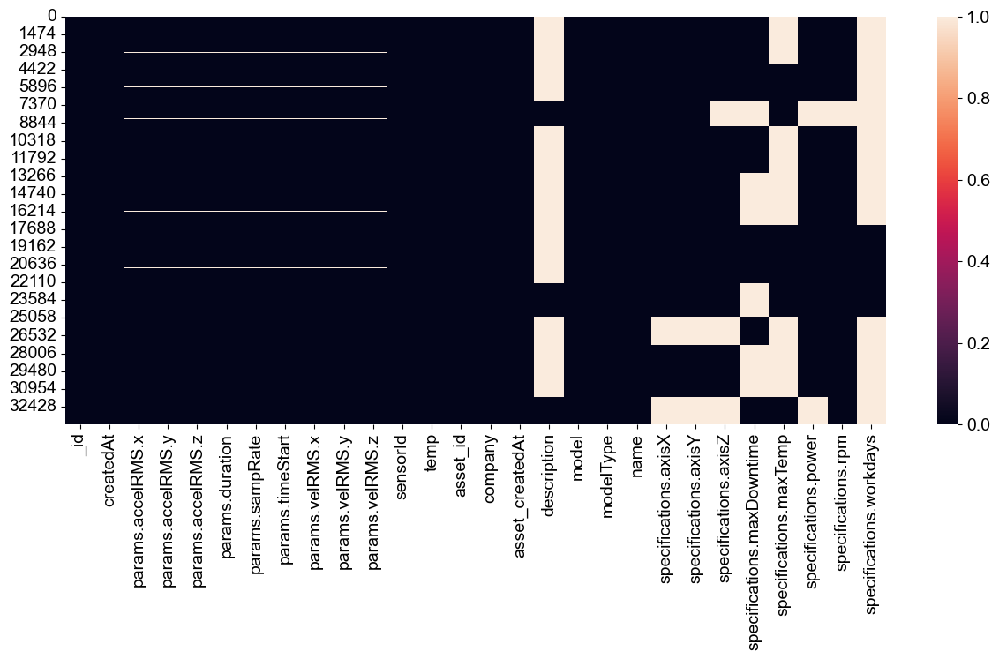

In [13]:
sns.heatmap(df.isnull())

Removing columns with so many null values that interpolation cannot be applied or that the column becomes useless

In [14]:
df.drop(['specifications.workdays', 'description'], axis=1, inplace=True)

Linear interpolation of all numerical columns

In [15]:
df.columns[2:11]

Index(['params.accelRMS.x', 'params.accelRMS.y', 'params.accelRMS.z',
       'params.duration', 'params.sampRate', 'params.timeStart',
       'params.velRMS.x', 'params.velRMS.y', 'params.velRMS.z'],
      dtype='object')

<AxesSubplot:>

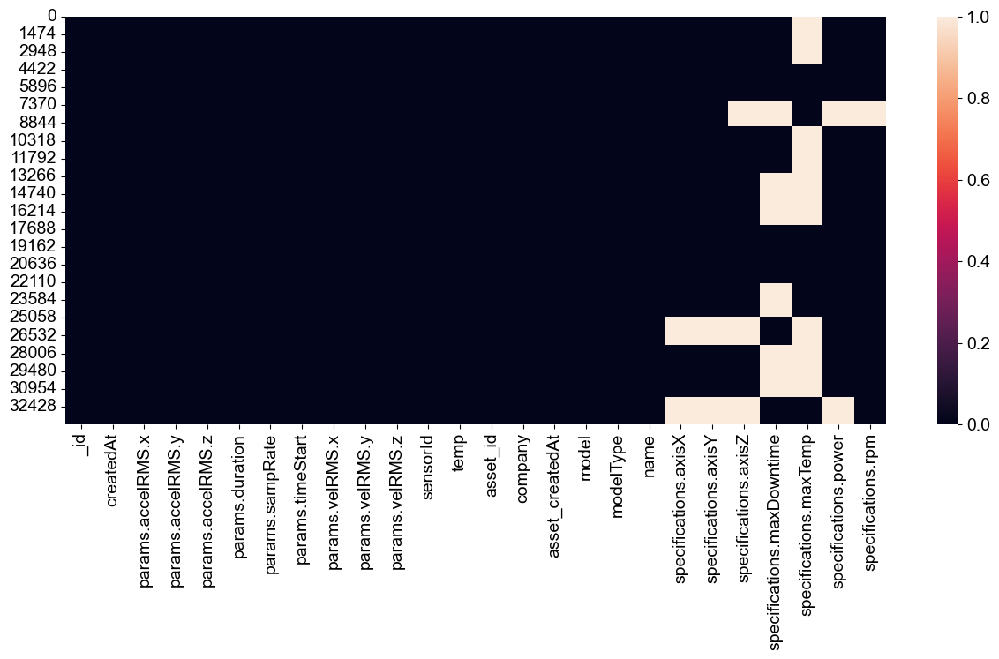

In [16]:
df[df.columns[2:11]] = df[df.columns[2:11]].interpolate(method='linear', limit_direction='both',axis=0)
df.reset_index(drop=True,inplace=True)
sns.heatmap(df.isnull())

In [17]:
df

,_id,createdAt,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.sampRate,params.timeStart,params.velRMS.x,params.velRMS.y,...,model,modelType,name,specifications.axisX,specifications.axisY,specifications.axisZ,specifications.maxDowntime,specifications.maxTemp,specifications.power,specifications.rpm
0,60b57955f77013684c413e39,2021-06-01T00:03:33.370Z,0.010463,0.004463,0.011677,3.006,1656.686627,1.622506e+09,0.000511,0.000176,...,60241102ed8ef30e9d309af9,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,vertical,horizontal,axial,48.0,NaN,3.7,1735.0
1,60b57c53f77013684c41409f,2021-06-01T00:16:19.173Z,0.011437,0.004983,0.011482,3.006,1656.686627,1.622507e+09,0.000633,0.000238,...,60241102ed8ef30e9d309af9,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,vertical,horizontal,axial,48.0,NaN,3.7,1735.0
2,60b57f34f77013684c4142cd,2021-06-01T00:28:36.553Z,0.010494,0.005024,0.011120,3.006,1656.686627,1.622507e+09,0.000524,0.000226,...,60241102ed8ef30e9d309af9,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,vertical,horizontal,axial,48.0,NaN,3.7,1735.0
3,60b58237f77013684c41450c,2021-06-01T00:41:27.622Z,0.009859,0.004786,0.011096,3.006,1656.686627,1.622508e+09,0.000437,0.000220,...,60241102ed8ef30e9d309af9,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,vertical,horizontal,axial,48.0,NaN,3.7,1735.0
4,60b58515f77013684c414765,2021-06-01T00:53:41.450Z,0.010014,0.005213,0.011332,3.006,1656.686627,1.622509e+09,0.000501,0.000251,...,60241102ed8ef30e9d309af9,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,vertical,horizontal,axial,48.0,NaN,3.7,1735.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33896,60e4ee0b35645405b62ea2f5,2021-07-06T23:58:03.000Z,0.048851,0.080684,0.063319,2.710,1527.306273,1.625616e+09,0.000762,0.001369,...,5f71d44867198d5d37e27d4f,other,ROTULADORA SIDEL,NaN,NaN,NaN,1.0,70.0,NaN,1458.0
33897,60e4f20435645405b62ea5b4,2021-07-07T00:15:00.431Z,0.049630,0.084657,0.065195,2.710,1527.306273,1.625617e+09,0.000791,0.001380,...,5f71d44867198d5d37e27d4f,other,ROTULADORA SIDEL,NaN,NaN,NaN,1.0,70.0,NaN,1458.0
33898,60e4f62635645405b62ea8b5,2021-07-07T00:32:38.904Z,0.048705,0.069750,0.132227,2.712,1526.179941,1.625618e+09,0.000725,0.001206,...,5f71d44867198d5d37e27d4f,other,ROTULADORA SIDEL,NaN,NaN,NaN,1.0,70.0,NaN,1458.0
33899,60e4fa6035645405b62eabaf,2021-07-07T00:50:40.423Z,0.049600,0.068588,0.131735,2.711,1526.742899,1.625619e+09,0.000740,0.001337,...,5f71d44867198d5d37e27d4f,other,ROTULADORA SIDEL,NaN,NaN,NaN,1.0,70.0,NaN,1458.0


# Question 1: Obtain downtime and uptime of an equipment

Downtime $(T_d)$ and uptime $(T_u)$ sare given by expressions (1) and (2) respectively:

$$T_d = \frac{T_{down}}{T_{monitored}} \tag{1}$$

$$T_u = 1 - T_d \tag{2}$$

Será removido as colunas inúteis para esse problema

We have the variable $T_{down}$ in column 'specifications.maxDowntime' while variable $T_{monitored}$ can be obtained if we know the time that the sensor measured. We will need to create this colun

<AxesSubplot:>

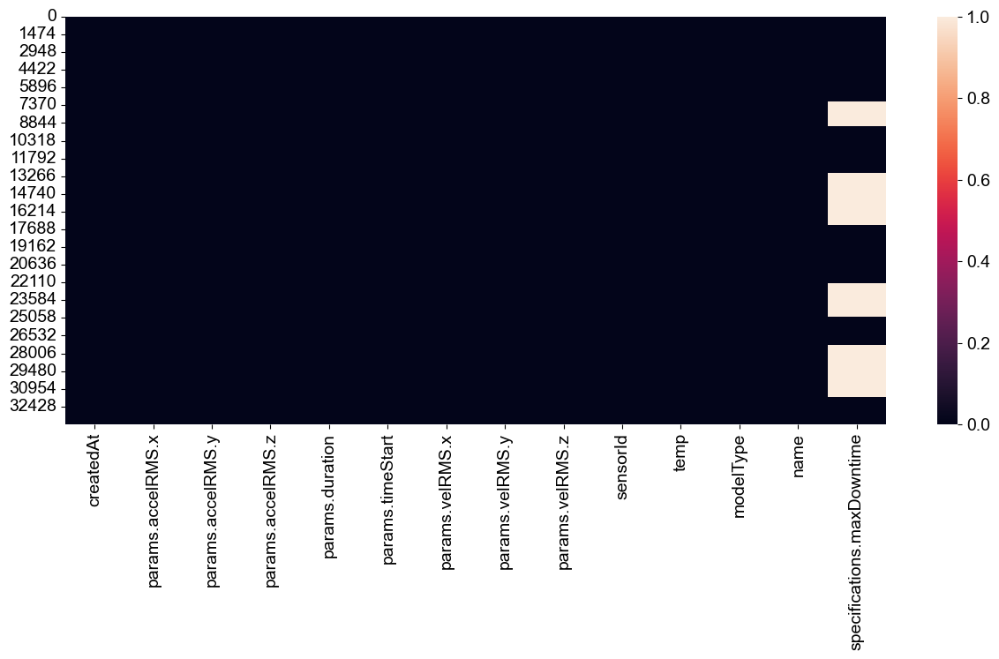

In [18]:
df3 = df.copy()

df3.drop(['_id', 'asset_id', 'asset_createdAt',
          'params.sampRate',
          'specifications.axisX', 'specifications.axisY', 'specifications.axisZ',
          'specifications.maxTemp', 'specifications.power', 'specifications.rpm',
          'company','model'], axis=1, inplace=True)

sns.heatmap(df3.isnull())

Observe that there are some rows where the maximum dowmtime is unknown. These rows must be removed since we need this information for estimating dowmtime and uptime

<AxesSubplot:>

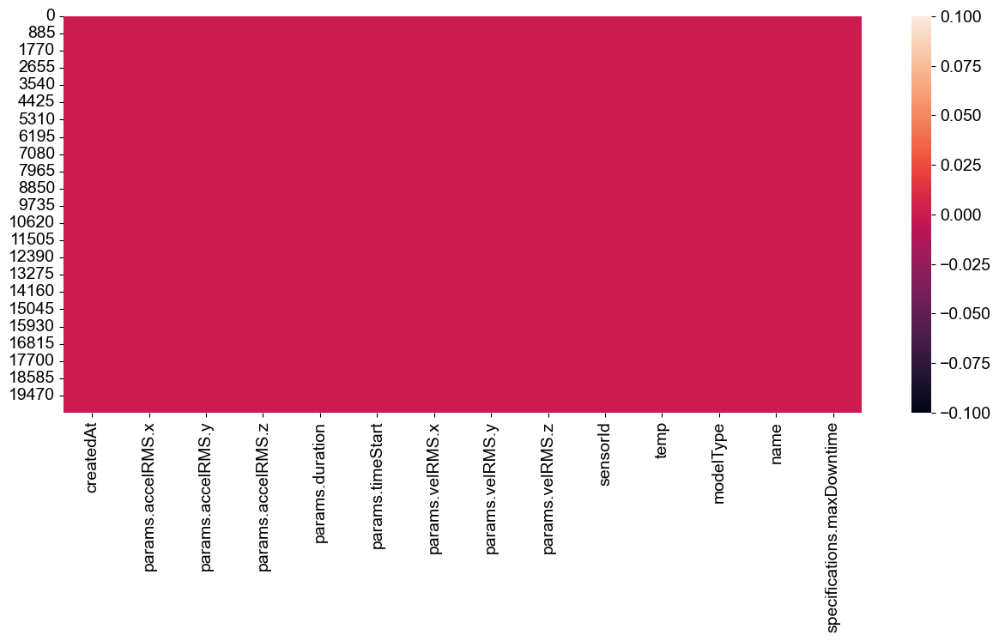

In [19]:
df3 = df3.dropna(axis=0)
df3.reset_index(drop=True, inplace=True)
sns.heatmap(df3.isnull())

In [20]:
df3

,createdAt,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.timeStart,params.velRMS.x,params.velRMS.y,params.velRMS.z,sensorId,temp,modelType,name,specifications.maxDowntime
0,2021-06-01T00:03:33.370Z,0.010463,0.004463,0.011677,3.006,1.622506e+09,0.000511,0.000176,0.000289,IAJ9206,23.94,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0
1,2021-06-01T00:16:19.173Z,0.011437,0.004983,0.011482,3.006,1.622507e+09,0.000633,0.000238,0.000292,IAJ9206,23.19,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0
2,2021-06-01T00:28:36.553Z,0.010494,0.005024,0.011120,3.006,1.622507e+09,0.000524,0.000226,0.000246,IAJ9206,22.50,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0
3,2021-06-01T00:41:27.622Z,0.009859,0.004786,0.011096,3.006,1.622508e+09,0.000437,0.000220,0.000248,IAJ9206,22.87,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0
4,2021-06-01T00:53:41.450Z,0.010014,0.005213,0.011332,3.006,1.622509e+09,0.000501,0.000251,0.000275,IAJ9206,22.56,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20346,2021-07-06T23:58:03.000Z,0.048851,0.080684,0.063319,2.710,1.625616e+09,0.000762,0.001369,0.001054,NEW4797,54.98,other,ROTULADORA SIDEL,1.0
20347,2021-07-07T00:15:00.431Z,0.049630,0.084657,0.065195,2.710,1.625617e+09,0.000791,0.001380,0.001174,NEW4797,55.35,other,ROTULADORA SIDEL,1.0
20348,2021-07-07T00:32:38.904Z,0.048705,0.069750,0.132227,2.712,1.625618e+09,0.000725,0.001206,0.001403,NEW4797,55.64,other,ROTULADORA SIDEL,1.0
20349,2021-07-07T00:50:40.423Z,0.049600,0.068588,0.131735,2.711,1.625619e+09,0.000740,0.001337,0.001374,NEW4797,55.78,other,ROTULADORA SIDEL,1.0


## Creating the time column from date column

In [21]:
# Removing decimal placed from variable "createdAt"

df3['createdAt'] = cut_date_decimal_places(df=df3, column='createdAt', position=-5)

In [22]:
df3

,createdAt,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.timeStart,params.velRMS.x,params.velRMS.y,params.velRMS.z,sensorId,temp,modelType,name,specifications.maxDowntime
0,2021-06-01T00:03:33,0.010463,0.004463,0.011677,3.006,1.622506e+09,0.000511,0.000176,0.000289,IAJ9206,23.94,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0
1,2021-06-01T00:16:19,0.011437,0.004983,0.011482,3.006,1.622507e+09,0.000633,0.000238,0.000292,IAJ9206,23.19,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0
2,2021-06-01T00:28:36,0.010494,0.005024,0.011120,3.006,1.622507e+09,0.000524,0.000226,0.000246,IAJ9206,22.50,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0
3,2021-06-01T00:41:27,0.009859,0.004786,0.011096,3.006,1.622508e+09,0.000437,0.000220,0.000248,IAJ9206,22.87,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0
4,2021-06-01T00:53:41,0.010014,0.005213,0.011332,3.006,1.622509e+09,0.000501,0.000251,0.000275,IAJ9206,22.56,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20346,2021-07-06T23:58:03,0.048851,0.080684,0.063319,2.710,1.625616e+09,0.000762,0.001369,0.001054,NEW4797,54.98,other,ROTULADORA SIDEL,1.0
20347,2021-07-07T00:15:00,0.049630,0.084657,0.065195,2.710,1.625617e+09,0.000791,0.001380,0.001174,NEW4797,55.35,other,ROTULADORA SIDEL,1.0
20348,2021-07-07T00:32:38,0.048705,0.069750,0.132227,2.712,1.625618e+09,0.000725,0.001206,0.001403,NEW4797,55.64,other,ROTULADORA SIDEL,1.0
20349,2021-07-07T00:50:40,0.049600,0.068588,0.131735,2.711,1.625619e+09,0.000740,0.001337,0.001374,NEW4797,55.78,other,ROTULADORA SIDEL,1.0


In [23]:
import dateutil.parser

sensor_list = df3['sensorId'].unique()
df4 = pd.DataFrame()

for sensor in sensor_list:

    df_aux = df3.loc[(df3['sensorId'] == sensor)]
    df_aux['Date'] = df_aux['createdAt'].apply(lambda row: dateutil.parser.parse(row))
    
    # Converting date into total seconds
    df_aux['Time'] = df_aux['Date'].apply(lambda row: row.timestamp())
    
    # Subtracting inicial time value so that time starts at 0
    df_aux['Time'] = df_aux['Time'] - df_aux.iloc[0, -1]

    df4 = pd.concat([df4, df_aux], axis=0)
    df4.drop(['Date'], inplace=True, axis=1)

df4

C:\Users\wingd\AppData\Local\Temp/ipykernel_13448/2038123011.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_aux['Date'] = df_aux['createdAt'].apply(lambda row: dateutil.parser.parse(row))
C:\Users\wingd\AppData\Local\Temp/ipykernel_13448/2038123011.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_aux['Time'] = df_aux['Date'].apply(lambda row: row.timestamp())
C:\Users\wingd\AppData\Local\Temp/ipykernel_13448/2038123011.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a

,createdAt,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.timeStart,params.velRMS.x,params.velRMS.y,params.velRMS.z,sensorId,temp,modelType,name,specifications.maxDowntime,Time
0,2021-06-01T00:03:33,0.010463,0.004463,0.011677,3.006,1.622506e+09,0.000511,0.000176,0.000289,IAJ9206,23.94,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,0.0
1,2021-06-01T00:16:19,0.011437,0.004983,0.011482,3.006,1.622507e+09,0.000633,0.000238,0.000292,IAJ9206,23.19,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,766.0
2,2021-06-01T00:28:36,0.010494,0.005024,0.011120,3.006,1.622507e+09,0.000524,0.000226,0.000246,IAJ9206,22.50,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,1503.0
3,2021-06-01T00:41:27,0.009859,0.004786,0.011096,3.006,1.622508e+09,0.000437,0.000220,0.000248,IAJ9206,22.87,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,2274.0
4,2021-06-01T00:53:41,0.010014,0.005213,0.011332,3.006,1.622509e+09,0.000501,0.000251,0.000275,IAJ9206,22.56,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,3008.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20346,2021-07-06T23:58:03,0.048851,0.080684,0.063319,2.710,1.625616e+09,0.000762,0.001369,0.001054,NEW4797,54.98,other,ROTULADORA SIDEL,1.0,3109954.0
20347,2021-07-07T00:15:00,0.049630,0.084657,0.065195,2.710,1.625617e+09,0.000791,0.001380,0.001174,NEW4797,55.35,other,ROTULADORA SIDEL,1.0,3110971.0
20348,2021-07-07T00:32:38,0.048705,0.069750,0.132227,2.712,1.625618e+09,0.000725,0.001206,0.001403,NEW4797,55.64,other,ROTULADORA SIDEL,1.0,3112029.0
20349,2021-07-07T00:50:40,0.049600,0.068588,0.131735,2.711,1.625619e+09,0.000740,0.001337,0.001374,NEW4797,55.78,other,ROTULADORA SIDEL,1.0,3113111.0


In [24]:
# Fixing the data column
df4['createdAt'] = pd.to_datetime(df4['createdAt'], format='%Y-%m-%dT%H:%M:%S')
df4

,createdAt,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.timeStart,params.velRMS.x,params.velRMS.y,params.velRMS.z,sensorId,temp,modelType,name,specifications.maxDowntime,Time
0,2021-06-01 00:03:33,0.010463,0.004463,0.011677,3.006,1.622506e+09,0.000511,0.000176,0.000289,IAJ9206,23.94,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,0.0
1,2021-06-01 00:16:19,0.011437,0.004983,0.011482,3.006,1.622507e+09,0.000633,0.000238,0.000292,IAJ9206,23.19,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,766.0
2,2021-06-01 00:28:36,0.010494,0.005024,0.011120,3.006,1.622507e+09,0.000524,0.000226,0.000246,IAJ9206,22.50,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,1503.0
3,2021-06-01 00:41:27,0.009859,0.004786,0.011096,3.006,1.622508e+09,0.000437,0.000220,0.000248,IAJ9206,22.87,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,2274.0
4,2021-06-01 00:53:41,0.010014,0.005213,0.011332,3.006,1.622509e+09,0.000501,0.000251,0.000275,IAJ9206,22.56,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,3008.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20346,2021-07-06 23:58:03,0.048851,0.080684,0.063319,2.710,1.625616e+09,0.000762,0.001369,0.001054,NEW4797,54.98,other,ROTULADORA SIDEL,1.0,3109954.0
20347,2021-07-07 00:15:00,0.049630,0.084657,0.065195,2.710,1.625617e+09,0.000791,0.001380,0.001174,NEW4797,55.35,other,ROTULADORA SIDEL,1.0,3110971.0
20348,2021-07-07 00:32:38,0.048705,0.069750,0.132227,2.712,1.625618e+09,0.000725,0.001206,0.001403,NEW4797,55.64,other,ROTULADORA SIDEL,1.0,3112029.0
20349,2021-07-07 00:50:40,0.049600,0.068588,0.131735,2.711,1.625619e+09,0.000740,0.001337,0.001374,NEW4797,55.78,other,ROTULADORA SIDEL,1.0,3113111.0


<AxesSubplot:xlabel='modelType', ylabel='Time'>

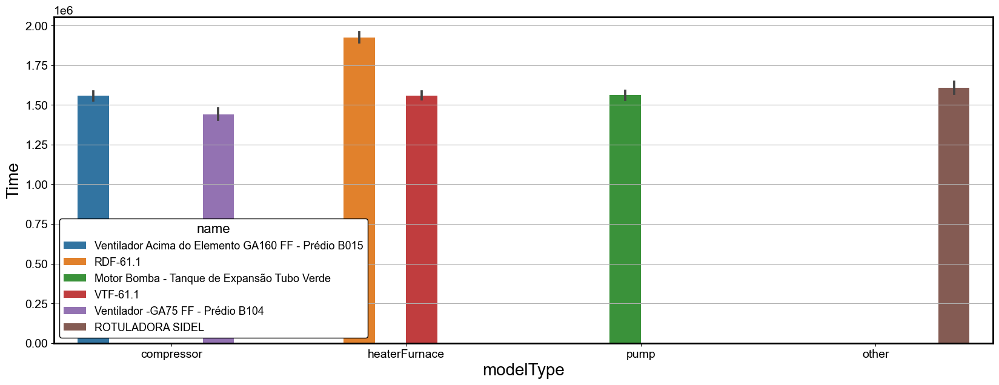

In [25]:
plt.figure(figsize=(20, 7))

sns.barplot(data=df4,
            x="modelType",
            y='Time',
            hue="name",
            dodge=True
            )

## Calculating downtime and uptime

The unit of 'specifications.maxDowntime' was not given and we know that the recently created column 'Time' is in seconds.

Supposing that'specifications.maxDowntime' is in hours horas, it will be converted into seconds before calculating downtime and uptime:

In [26]:
df4['scaled maxDowntime'] = (df4['specifications.maxDowntime']*(24*60))/df4['Time']
df4

,createdAt,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.timeStart,params.velRMS.x,params.velRMS.y,params.velRMS.z,sensorId,temp,modelType,name,specifications.maxDowntime,Time,scaled maxDowntime
0,2021-06-01 00:03:33,0.010463,0.004463,0.011677,3.006,1.622506e+09,0.000511,0.000176,0.000289,IAJ9206,23.94,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,0.0,inf
1,2021-06-01 00:16:19,0.011437,0.004983,0.011482,3.006,1.622507e+09,0.000633,0.000238,0.000292,IAJ9206,23.19,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,766.0,90.234987
2,2021-06-01 00:28:36,0.010494,0.005024,0.011120,3.006,1.622507e+09,0.000524,0.000226,0.000246,IAJ9206,22.50,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,1503.0,45.988024
3,2021-06-01 00:41:27,0.009859,0.004786,0.011096,3.006,1.622508e+09,0.000437,0.000220,0.000248,IAJ9206,22.87,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,2274.0,30.395778
4,2021-06-01 00:53:41,0.010014,0.005213,0.011332,3.006,1.622509e+09,0.000501,0.000251,0.000275,IAJ9206,22.56,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,48.0,3008.0,22.978723
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20346,2021-07-06 23:58:03,0.048851,0.080684,0.063319,2.710,1.625616e+09,0.000762,0.001369,0.001054,NEW4797,54.98,other,ROTULADORA SIDEL,1.0,3109954.0,0.000463
20347,2021-07-07 00:15:00,0.049630,0.084657,0.065195,2.710,1.625617e+09,0.000791,0.001380,0.001174,NEW4797,55.35,other,ROTULADORA SIDEL,1.0,3110971.0,0.000463
20348,2021-07-07 00:32:38,0.048705,0.069750,0.132227,2.712,1.625618e+09,0.000725,0.001206,0.001403,NEW4797,55.64,other,ROTULADORA SIDEL,1.0,3112029.0,0.000463
20349,2021-07-07 00:50:40,0.049600,0.068588,0.131735,2.711,1.625619e+09,0.000740,0.001337,0.001374,NEW4797,55.78,other,ROTULADORA SIDEL,1.0,3113111.0,0.000463


In [27]:
names = df4['name'].unique()
print(names)

['Ventilador Acima do Elemento GA160 FF - Prédio B015' 'RDF-61.1'
 'Motor Bomba - Tanque de Expansão Tubo Verde  ' 'VTF-61.1'
 'Ventilador -GA75 FF - Prédio B104' 'ROTULADORA SIDEL ']


In [28]:
def obtain_downtime_uptime(df,machine_name):
    
    df_save = pd.DataFrame()

    for machines in machine_name:
        df_aux = df.loc[(df['name'] == machines)]

        # Criando as colunas
        df_aux['Downtime'] =  100 * df_aux['scaled maxDowntime'].min() # Supõe-se que o menor valor corresponde ao Downtime pois é quando acaba as medições
        df_aux['Uptime'] =  100 - df_aux['Downtime']

        df_save = pd.concat([df_save,df_aux],axis=0)

    # Salvando resultados 
    df_downtime = df_save[['name','Downtime','Uptime']]

    return df_downtime.drop_duplicates()

In [29]:
df_downtime = obtain_downtime_uptime(df=df4, machine_name=names)
df_downtime


C:\Users\wingd\AppData\Local\Temp/ipykernel_13448/1158255395.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_aux['Downtime'] =  100 * df_aux['scaled maxDowntime'].min() # Supõe-se que o menor valor corresponde ao Downtime pois é quando acaba as medições
C:\Users\wingd\AppData\Local\Temp/ipykernel_13448/1158255395.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_aux['Uptime'] =  100 - df_aux['Downtime']


,name,Downtime,Uptime
0,Ventilador Acima do Elemento GA160 FF - Prédio...,2.219508,97.780492
3986,RDF-61.1,0.011560,99.988440
7048,Motor Bomba - Tanque de Expansão Tubo Verde,2.219699,97.780301
10913,VTF-61.1,0.011560,99.988440
15739,Ventilador -GA75 FF - Prédio B104,2.240704,97.759296
18102,ROTULADORA SIDEL,0.046240,99.953760


# Question 2: Create a model to identify vibration pattern changes in an equipment

Since the question specifies specifically vibration patterns, the temperature column can be removed

## Preprocessing 

<AxesSubplot:>

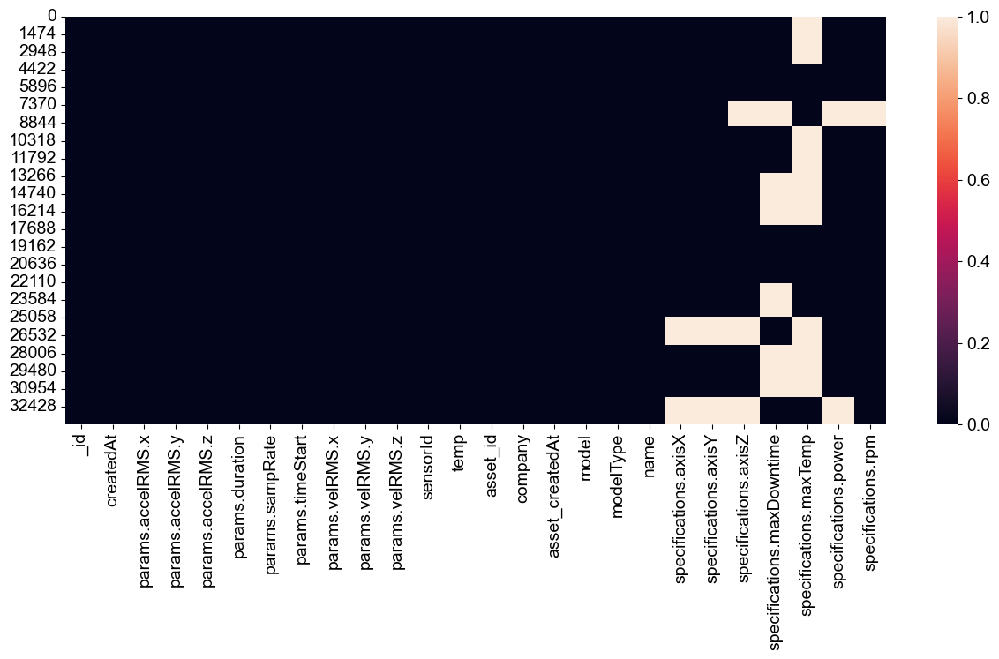

In [30]:
df5 = df.copy()
sns.heatmap(df5.isnull())

We will work with only numerical columns and the equipment names here

<AxesSubplot:>

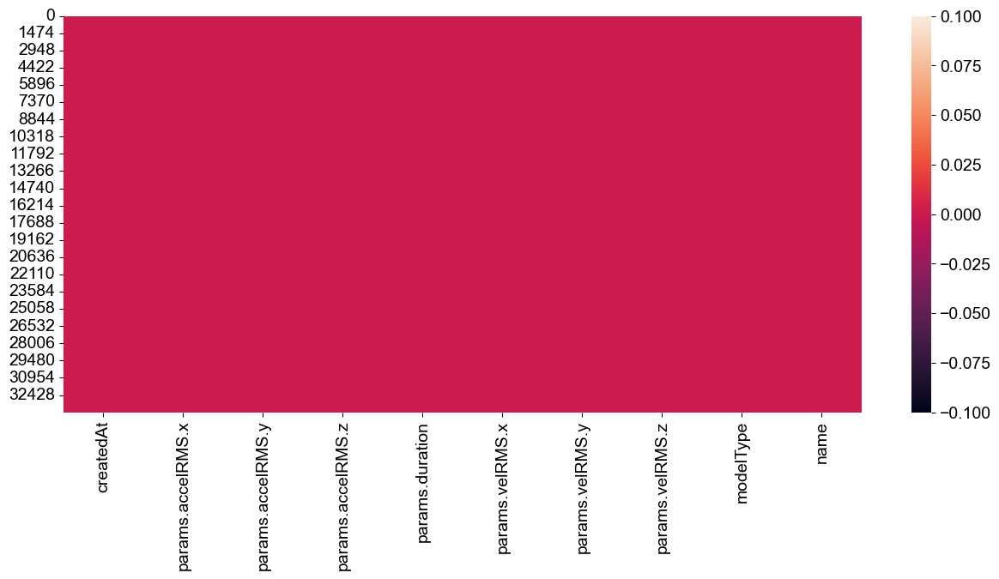

In [31]:
df5.drop(['_id', 'asset_id', 'asset_createdAt',
          'params.sampRate','params.timeStart',
          'temp',
          'specifications.axisX', 'specifications.axisY', 'specifications.axisZ',
          'specifications.maxTemp', 'specifications.power', 'specifications.rpm','specifications.maxDowntime',
          'company', 'model','sensorId'], axis=1, inplace=True)

df5['createdAt'] = cut_date_decimal_places(df=df5, column='createdAt', position=-5)
df5['createdAt'] = pd.to_datetime(df5['createdAt'], format='%Y-%m-%dT%H:%M:%S')
sns.heatmap(df5.isnull())


In [32]:
df5

,createdAt,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.velRMS.x,params.velRMS.y,params.velRMS.z,modelType,name
0,2021-06-01 00:03:33,0.010463,0.004463,0.011677,3.006,0.000511,0.000176,0.000289,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...
1,2021-06-01 00:16:19,0.011437,0.004983,0.011482,3.006,0.000633,0.000238,0.000292,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...
2,2021-06-01 00:28:36,0.010494,0.005024,0.011120,3.006,0.000524,0.000226,0.000246,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...
3,2021-06-01 00:41:27,0.009859,0.004786,0.011096,3.006,0.000437,0.000220,0.000248,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...
4,2021-06-01 00:53:41,0.010014,0.005213,0.011332,3.006,0.000501,0.000251,0.000275,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...
...,...,...,...,...,...,...,...,...,...,...
33896,2021-07-06 23:58:03,0.048851,0.080684,0.063319,2.710,0.000762,0.001369,0.001054,other,ROTULADORA SIDEL
33897,2021-07-07 00:15:00,0.049630,0.084657,0.065195,2.710,0.000791,0.001380,0.001174,other,ROTULADORA SIDEL
33898,2021-07-07 00:32:38,0.048705,0.069750,0.132227,2.712,0.000725,0.001206,0.001403,other,ROTULADORA SIDEL
33899,2021-07-07 00:50:40,0.049600,0.068588,0.131735,2.711,0.000740,0.001337,0.001374,other,ROTULADORA SIDEL


In [33]:
# Equipment names
name_list = df5['name'].unique()

# Filtered dataset for a specific machine

df_list = []
df_date_list = []
dt_list = []

for idx, name in enumerate(name_list):
    
    df_aux = df5.loc[(df5['name'] == name)]
    df_aux.reset_index(inplace=True,drop=True)     
                
    df_list.append(df_aux)
    df_date_list.append(df_list[idx].loc[:, 'createdAt'])
    dt_list.append(df_list[idx].loc[:, 'params.duration'].mean())
    
    
dt_list = np.round(dt_list,4)
subset = ['params.accelRMS.x','params.accelRMS.y','params.accelRMS.z','params.velRMS.x','params.velRMS.y','params.velRMS.z']

In [34]:
dt_list

array([3.006 , 3.0067, 4.7246, 3.006 , 2.9572, 3.006 , 4.0032, 3.0061,
       2.9571, 2.7109])

## Denoising the dataset

In [35]:
df_filtered_final = []

### Ventilador GA160 FF

6it [00:00, 545.62it/s]
6it [00:00, 500.10it/s]
6it [00:00, 545.64it/s]
6it [00:00, 1000.35it/s]
6it [00:00, 750.03it/s]
6it [00:00, 857.53it/s]


(0.0, 0.008)

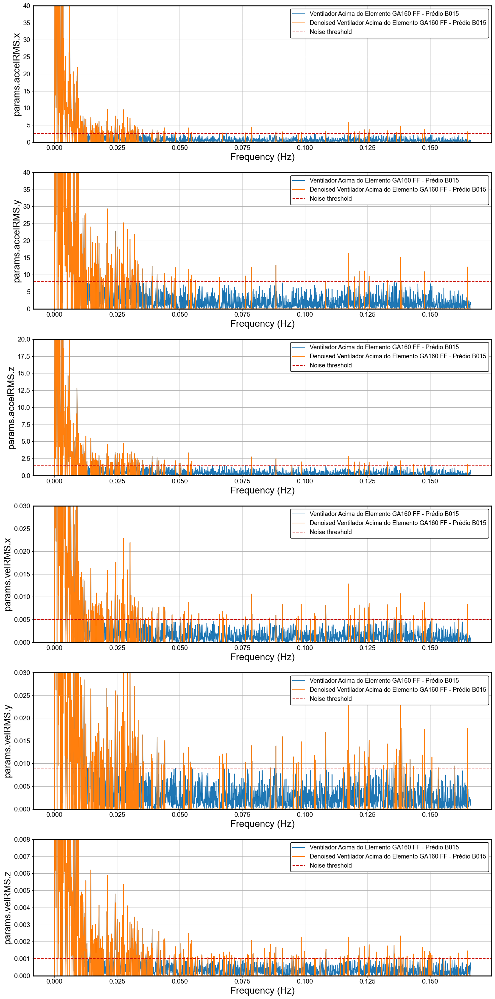

In [36]:
index = 0
threshold_list = [2.5,8,1.5,0.005,0.009,0.001]
fig, ax, df_FFT = plot_FFT(df_list[index], dt_list[index], subset=subset, legend=name_list[index],
                           nrows=len(subset), ncols=1, figsize=(15, 30),
                           plot_filtered=True, threshold_list=threshold_list)

ax[0].set_ylim([0, 40])
ax[1].set_ylim([0, 40])
ax[2].set_ylim([0, 20])
ax[3].set_ylim([0, 0.03])
ax[4].set_ylim([0, 0.03])
ax[5].set_ylim([0, 0.008])

In [37]:
df_filtered = ifft_df(df_list[index], df_FFT=df_FFT, dt=dt_list[index], subset=subset, threshold_list=threshold_list)

6it [00:00, 545.65it/s]


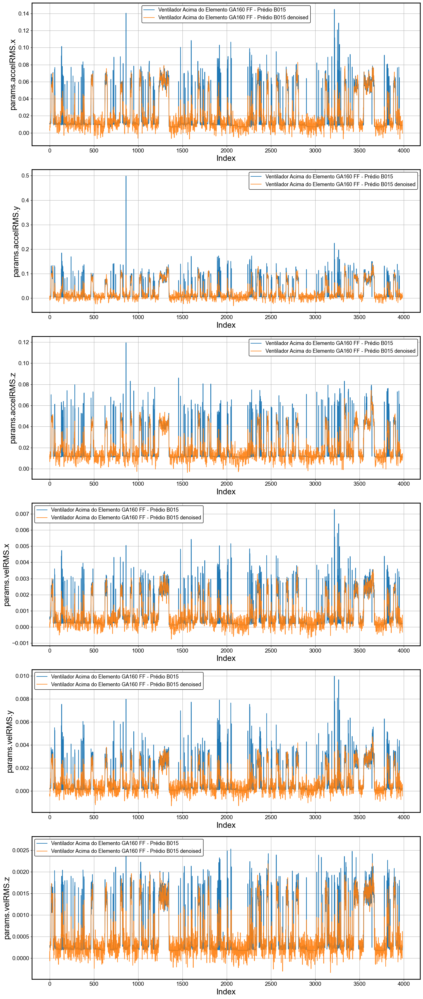

In [38]:
fig, ax = compare_filtered_unfiltered(df_list[index], df_filtered, subset=subset, legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 35))

 Applying butterworth lowpass filter

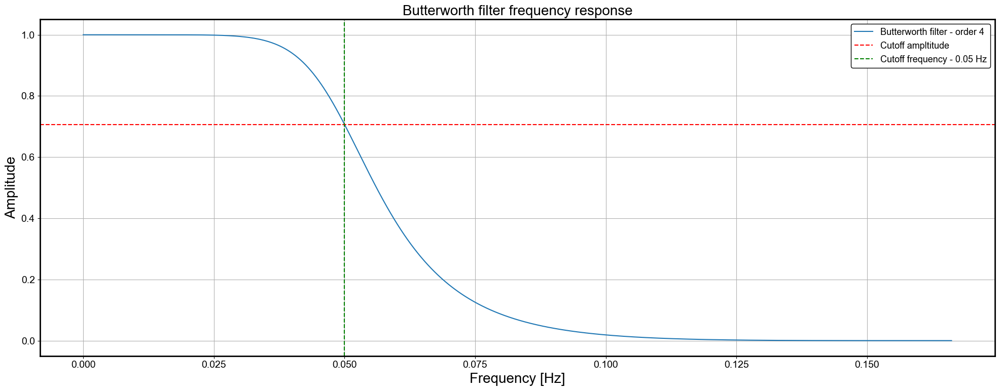

In [39]:
b, a = butterworth_filter(order=4, cutoff=0.050,fs=1/(dt_list[index]), btype='lowpass', plot=True)

We will use a low pass butterworth filter to remove high frequency components

The cutoff frequency coincides with the amplitude of 0.707 or -3dB. By adjusting the order of the filter, the user can define how fast the frequency response goes from amplitude 1 to amplitude 0

In [40]:
df_butter_filtered = apply_butterfilter_df(df=df_filtered, order=4, cutoff=0.050, fs=1/(dt_list[index]), btype='lowpass')
df_filtered_final.append(df_butter_filtered)
print(len(df_filtered))

100%|██████████| 6/6 [00:00<00:00, 67.44it/s]

6


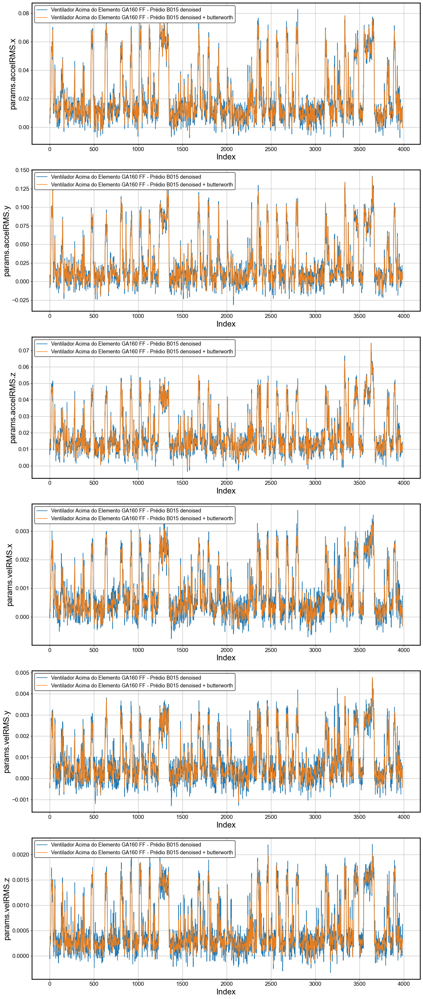

In [41]:
fig, ax = compare_filtered_signals(df_filtered, df_butter_filtered,subset=subset,legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 35))

### RDF - 61.1

6it [00:00, 1499.84it/s]
6it [00:00, 1200.60it/s]
6it [00:00, 1000.39it/s]
6it [00:00, 1500.73it/s]
6it [00:00, 1500.47it/s]
6it [00:00, 1200.54it/s]


(0.0, 3e-06)

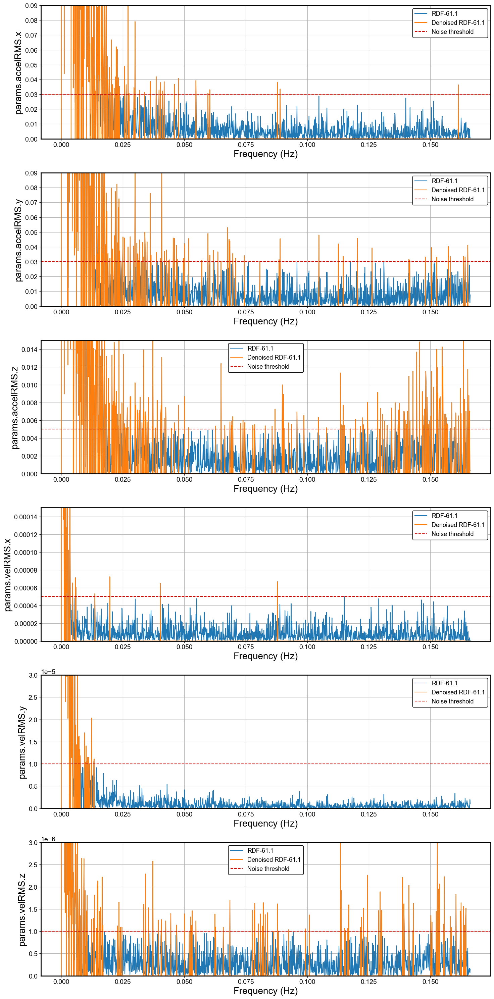

In [42]:
index = 1
threshold_list = [0.03,0.03,0.005,5e-5,1e-5,1e-6]
fig, ax, df_FFT = plot_FFT(df_list[index], dt_list[index], subset=subset, legend=name_list[index],
                           nrows=len(subset), ncols=1, figsize=(15, 30),
                           plot_filtered=True, threshold_list=threshold_list)

ax[0].set_ylim([0, threshold_list[0]*3])
ax[1].set_ylim([0, threshold_list[1]*3])
ax[2].set_ylim([0, threshold_list[2]*3])
ax[3].set_ylim([0, threshold_list[3]*3])
ax[4].set_ylim([0, threshold_list[4]*3])
ax[5].set_ylim([0, threshold_list[5]*3])

In [43]:
df_filtered = ifft_df(df_list[index], df_FFT=df_FFT, dt=dt_list[index], subset=subset, threshold_list=threshold_list)

6it [00:00, 857.44it/s]


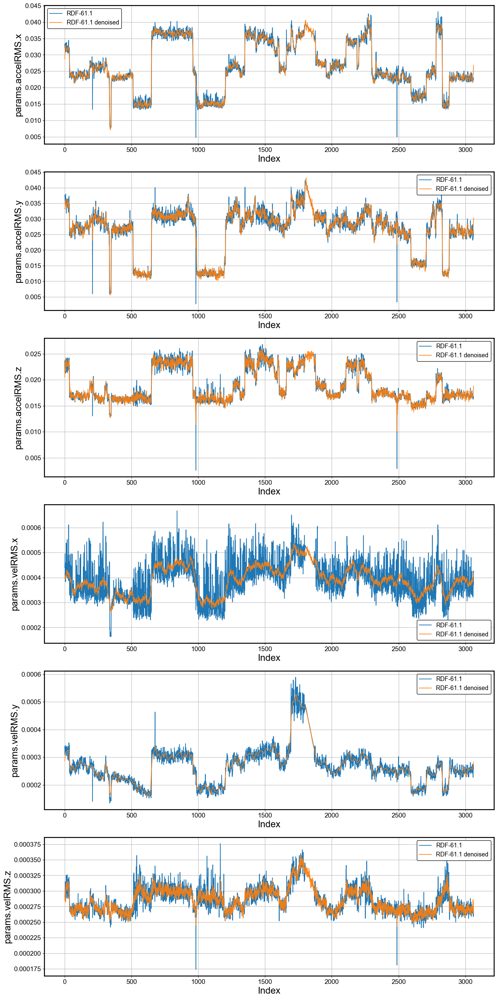

In [44]:
fig, ax = compare_filtered_unfiltered(df_list[index], df_filtered, subset=subset, legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 30))

 Applying butterworth lowpass filter

In [45]:
#%pylab
b, a = butterworth_filter(order=4, cutoff=0.050,fs=1/(dt_list[index]), btype='lowpass', plot=False)

We will use a low pass butterworth filter to remove high frequency components

The cutoff frequency coincides with the amplitude of 0.707 or -3dB. By adjusting the order of the filter, the user can define how fast the frequency response goes from amplitude 1 to amplitude 0

In [46]:
df_butter_filtered = apply_butterfilter_df(df=df_filtered, order=4, cutoff=0.050, fs=1/(dt_list[index]), btype='lowpass')
df_filtered_final.append(df_butter_filtered)

100%|██████████| 6/6 [00:00<00:00, 1200.26it/s]


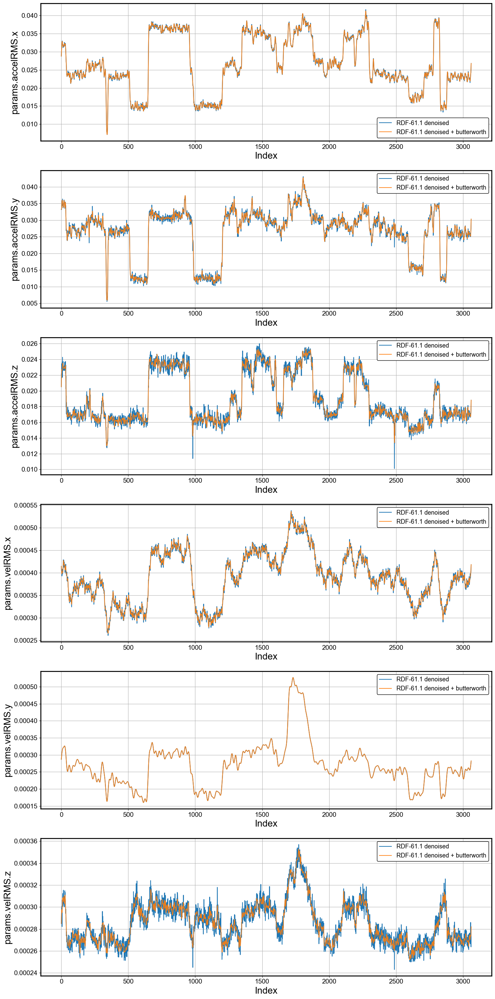

In [47]:
fig, ax = compare_filtered_signals(df_filtered, df_butter_filtered,subset=subset,legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 30))

Looks like only applying a lowpass filter is sufficient for denoising the dataset. Lets do that for the other sensors

### Transformador 500 KVA N1

6it [00:00, 1500.20it/s]


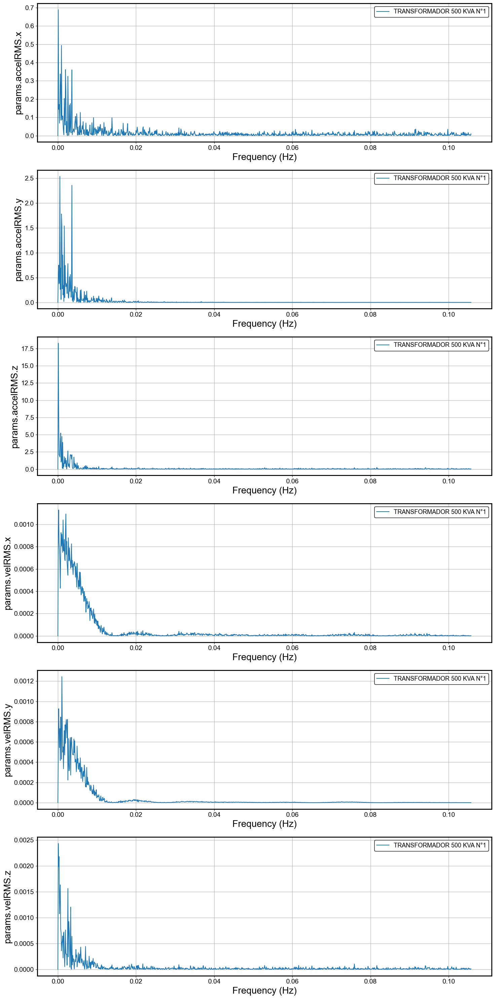

In [48]:
index = 2
threshold_list = [0.0,0.0,0.0,0,0,0]
fig, ax, df_FFT = plot_FFT(df_list[index], dt_list[index], subset=subset, legend=name_list[index],
                           nrows=len(subset), ncols=1, figsize=(15, 30),
                           plot_filtered=False, threshold_list=threshold_list)

df_filtered = ifft_df(df_list[index], df_FFT=df_FFT, dt=dt_list[index],subset=subset, threshold_list=threshold_list)

In [49]:
#%pylab
cutoff = 0.015
b, a = butterworth_filter(order=4, cutoff=cutoff, fs=1/(dt_list[index]), btype='lowpass', plot=False)

In [50]:
df_butter_filtered = apply_butterfilter_df(df=df_list[index], order=4, cutoff=cutoff, subset=subset, fs=1/(dt_list[index]), btype='lowpass')
df_filtered_final.append(df_butter_filtered)

100%|██████████| 6/6 [00:00<00:00, 1500.65it/s]


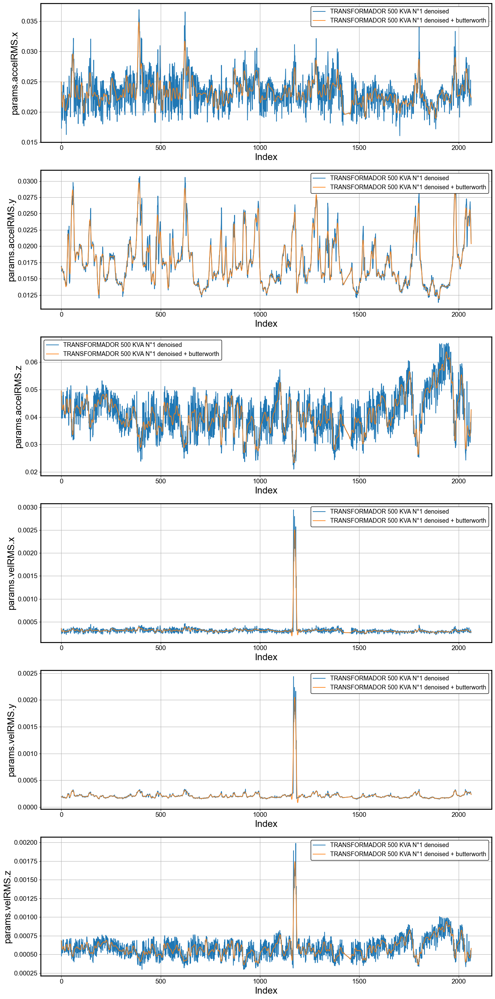

In [51]:
fig, ax = compare_filtered_signals(df_filtered, df_butter_filtered,subset=subset,legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 30))

### Motor Bomba - Tanque de Expansão Tubo Verde

6it [00:00, 857.44it/s]


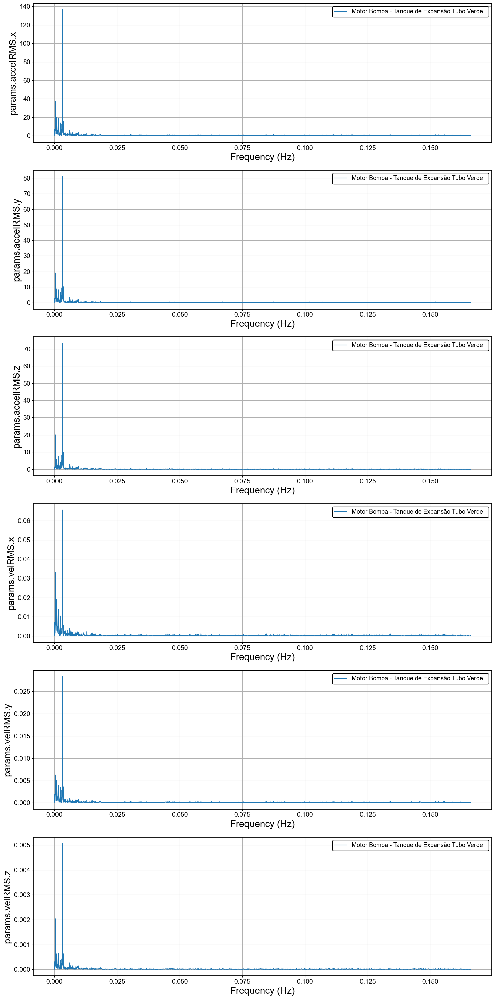

In [52]:
index = 3
threshold_list = [0.0,0.0,0.0,0,0,0]
fig, ax, df_FFT = plot_FFT(df_list[index], dt_list[index], subset=subset, legend=name_list[index],
                           nrows=len(subset), ncols=1, figsize=(15, 30),
                           plot_filtered=False, threshold_list=threshold_list)

df_filtered = ifft_df(df_list[index], df_FFT=df_FFT, dt=dt_list[index],subset=subset, threshold_list=threshold_list)

In [53]:
#%pylab
cutoff = 0.015
b, a = butterworth_filter(order=4, cutoff=cutoff, fs=1/(dt_list[index]), btype='lowpass', plot=False)

In [54]:
df_butter_filtered = apply_butterfilter_df(df=df_list[index], order=4, cutoff=cutoff, subset=subset, fs=1/(dt_list[index]), btype='lowpass')
df_filtered_final.append(df_butter_filtered)

100%|██████████| 6/6 [00:00<00:00, 2000.62it/s]


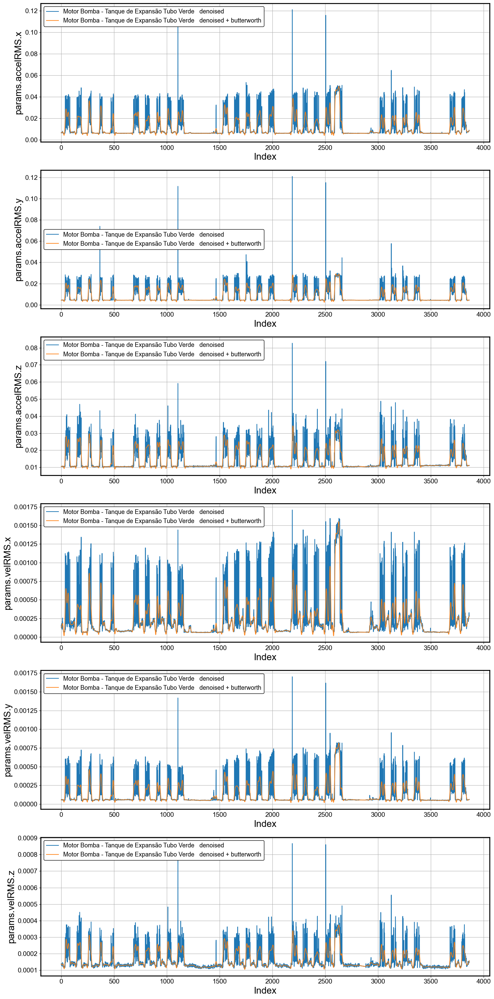

In [55]:
fig, ax = compare_filtered_signals(df_filtered, df_butter_filtered,subset=subset,legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 30))

### CAG1 - BAGS.12 - Motor

6it [00:00, 750.32it/s]


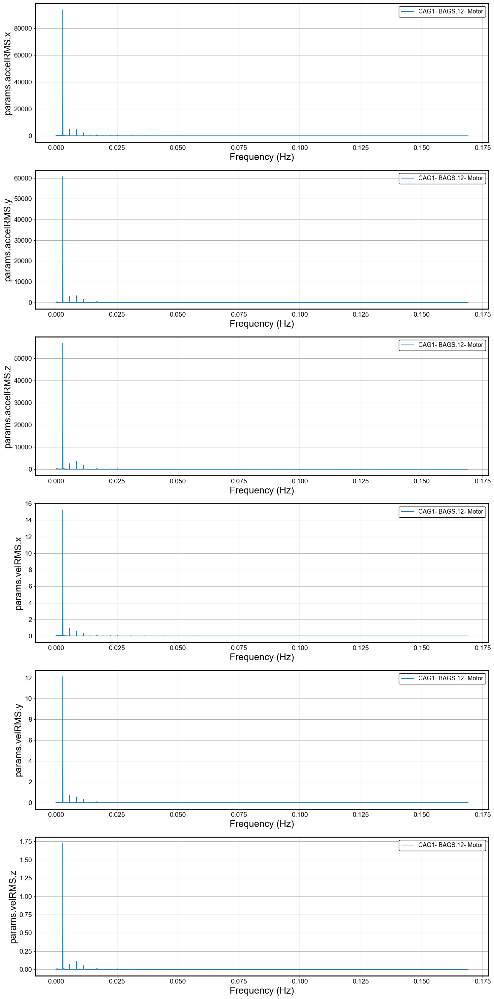

In [56]:
index = 4
threshold_list = [0.0,0.0,0.0,0,0,0]
fig, ax, df_FFT = plot_FFT(df_list[index], dt_list[index], subset=subset, legend=name_list[index],
                           nrows=len(subset), ncols=1, figsize=(15, 30),
                           plot_filtered=False, threshold_list=threshold_list)

df_filtered = ifft_df(df_list[index], df_FFT=df_FFT, dt=dt_list[index],subset=subset, threshold_list=threshold_list)

In [57]:
#%pylab
cutoff = 0.015
b, a = butterworth_filter(order=4, cutoff=cutoff, fs=1/(dt_list[index]), btype='lowpass', plot=False)

In [58]:
df_butter_filtered = apply_butterfilter_df(df=df_list[index], order=4, cutoff=cutoff, subset=subset, fs=1/(dt_list[index]), btype='lowpass')
df_filtered_final.append(df_butter_filtered)

100%|██████████| 6/6 [00:00<00:00, 1200.49it/s]


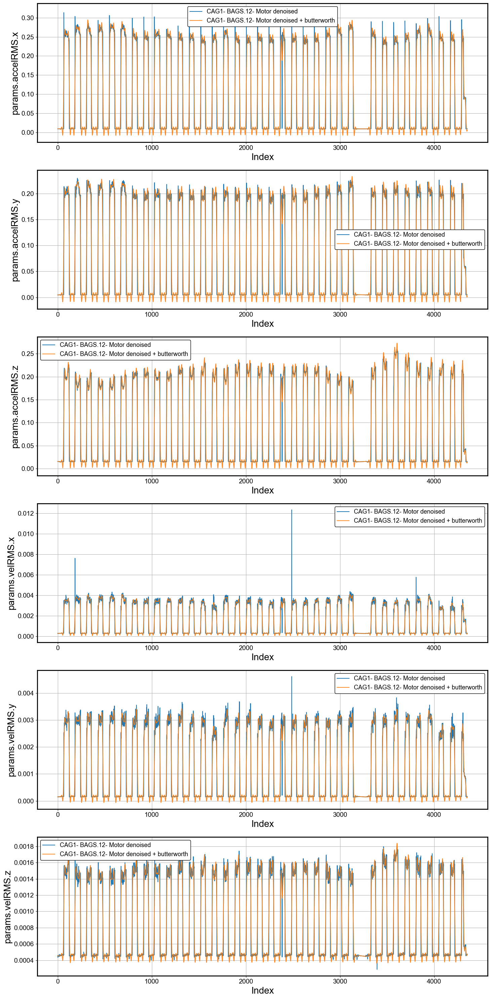

In [59]:
fig, ax = compare_filtered_signals(df_filtered, df_butter_filtered,subset=subset,legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 30))

### VTF - 61.1

6it [00:00, 1000.27it/s]


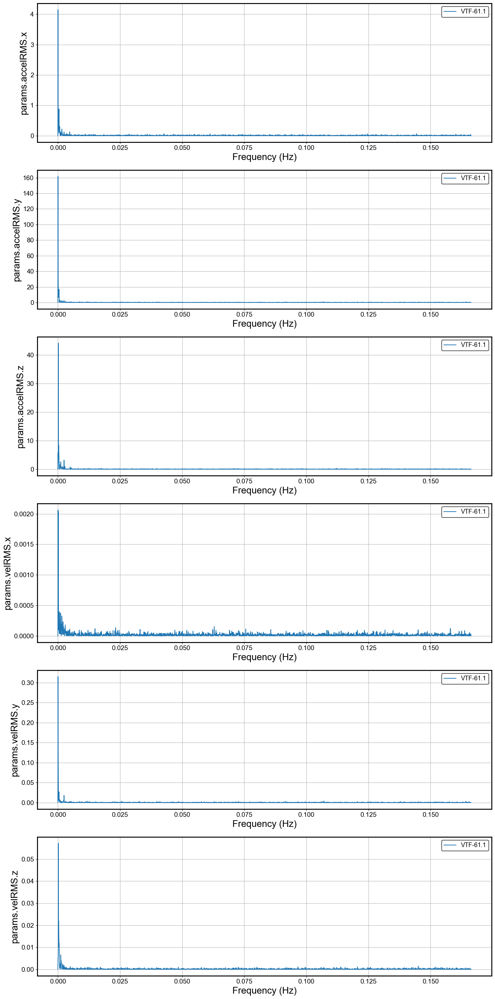

In [60]:
index = 5
threshold_list = [0.0, 0.0, 0.0, 0, 0, 0]
fig, ax, df_FFT = plot_FFT(df_list[index], dt_list[index], subset=subset, legend=name_list[index],
                           nrows=len(subset), ncols=1, figsize=(15, 30),
                           plot_filtered=False, threshold_list=threshold_list)

df_filtered = ifft_df(df_list[index], df_FFT=df_FFT, dt=dt_list[index],subset=subset, threshold_list=threshold_list)

In [61]:
cutoff = 0.015
b, a = butterworth_filter(order=4, cutoff=cutoff,fs=1/(dt_list[index]), btype='lowpass', plot=False)

df_butter_filtered = apply_butterfilter_df(df=df_list[index], order=4, cutoff=cutoff, subset=subset, fs=1/(dt_list[index]), btype='lowpass')
df_filtered_final.append(df_butter_filtered)

100%|██████████| 6/6 [00:00<00:00, 2001.10it/s]


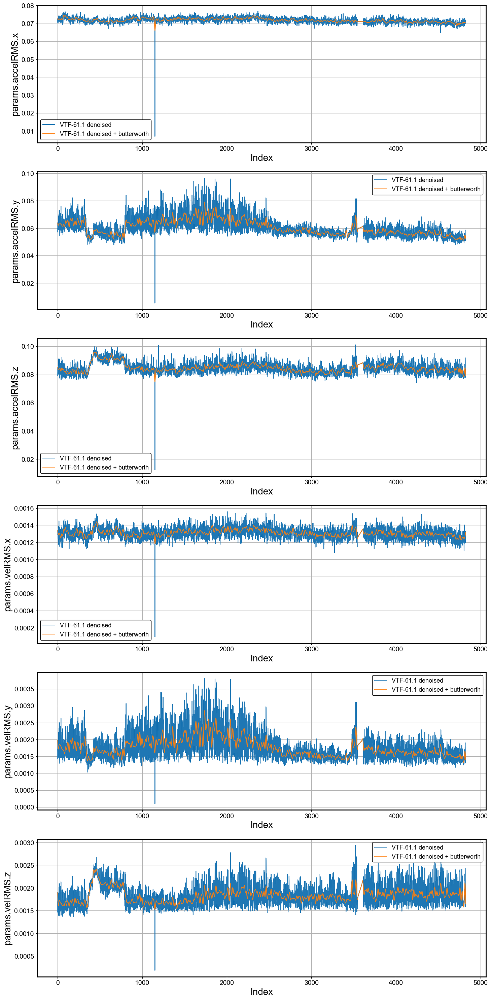

In [62]:
fig, ax = compare_filtered_signals(df_filtered, df_butter_filtered, subset=subset,legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 30))

### Boko MA - 1510 - Motor 2 da UH

6it [00:00, 1000.63it/s]


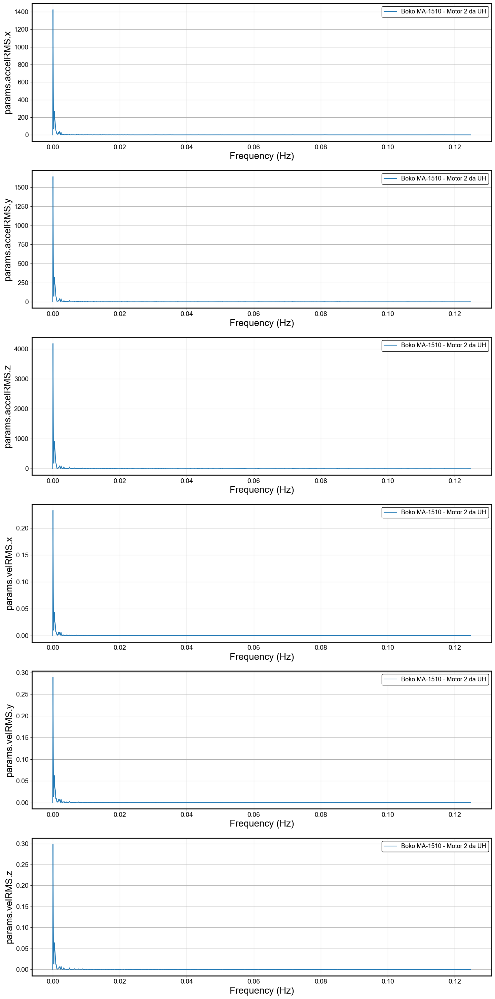

In [63]:
index = 6
threshold_list = [0.0,0.0,0.0,0,0,0]
fig, ax, df_FFT = plot_FFT(df_list[index], dt_list[index], subset=subset, legend=name_list[index],
                           nrows=len(subset), ncols=1, figsize=(15, 30),
                           plot_filtered=False, threshold_list=threshold_list)

df_filtered = ifft_df(df_list[index], df_FFT=df_FFT, dt=dt_list[index],subset=subset, threshold_list=threshold_list)

In [64]:
#%pylab
cutoff = 0.015
b, a = butterworth_filter(order=4, cutoff=cutoff, fs=1/(dt_list[index]), btype='lowpass', plot=False)

In [65]:
df_butter_filtered = apply_butterfilter_df(df=df_list[index], order=4, cutoff=cutoff, subset=subset, fs=1/(dt_list[index]), btype='lowpass')
df_filtered_final.append(df_butter_filtered)

100%|██████████| 6/6 [00:00<00:00, 1500.38it/s]


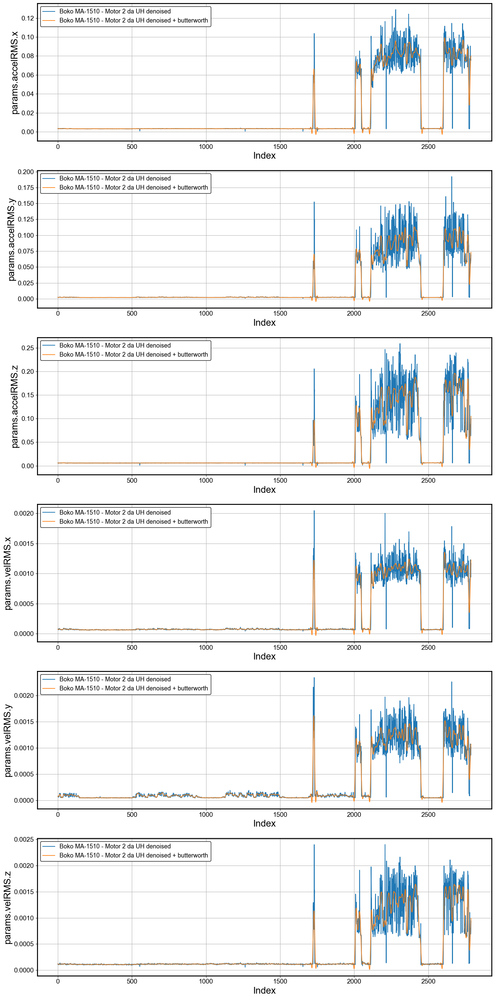

In [66]:
fig, ax = compare_filtered_signals(df_filtered, df_butter_filtered, subset=subset,
                                   legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 30))

### Ventilador GA75 FF

6it [00:00, 666.91it/s]
100%|██████████| 6/6 [00:00<00:00, 1500.47it/s]


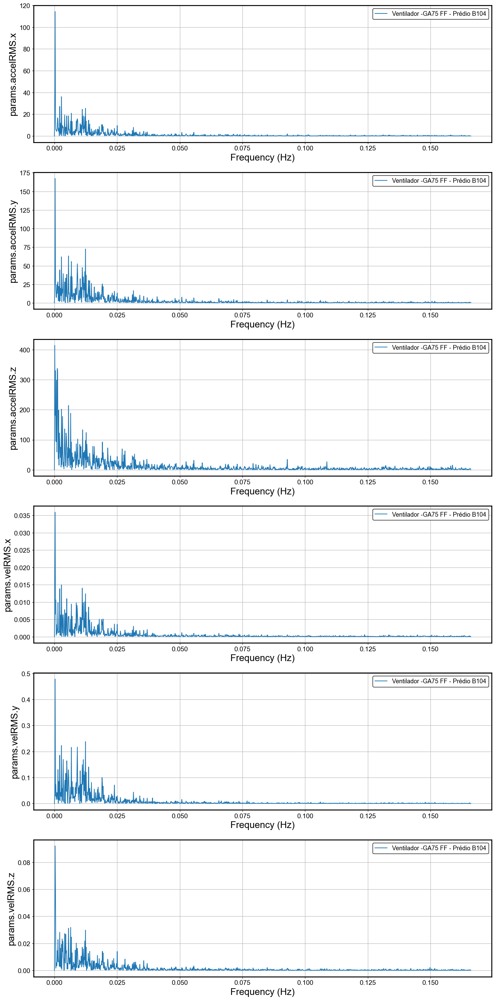

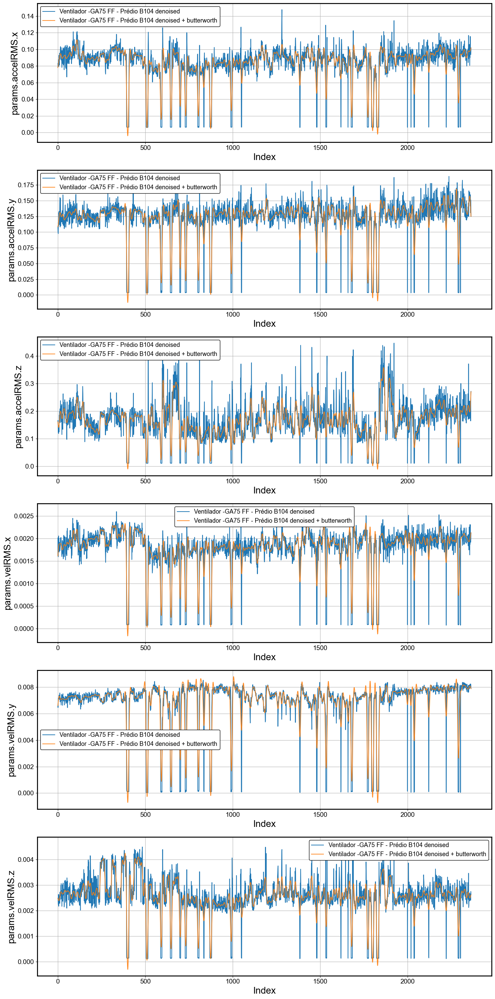

In [67]:
index = 7
threshold_list = [0.0, 0.0, 0.0, 0, 0, 0]
fig, ax, df_FFT = plot_FFT(df_list[index], dt_list[index], subset=subset, legend=name_list[index],
                           nrows=len(subset), ncols=1, figsize=(15, 30),
                           plot_filtered=False, threshold_list=threshold_list)

df_filtered = ifft_df(df_list[index], df_FFT=df_FFT, dt=dt_list[index],
                      subset=subset, threshold_list=threshold_list)

cutoff = 0.02
b, a = butterworth_filter(order=4, cutoff=cutoff,
                          fs=1/(dt_list[index]), btype='lowpass', plot=False)

df_butter_filtered = apply_butterfilter_df(df=df_list[index], order=4, cutoff=cutoff, subset=subset, fs=1/(dt_list[index]), btype='lowpass')
df_filtered_final.append(df_butter_filtered)

fig, ax = compare_filtered_signals(df_filtered, df_butter_filtered, subset=subset,
                                   legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 30))


### CAG1 - BAGS.3 - Motor

6it [00:00, 1000.31it/s]
100%|██████████| 6/6 [00:00<00:00, 3000.22it/s]


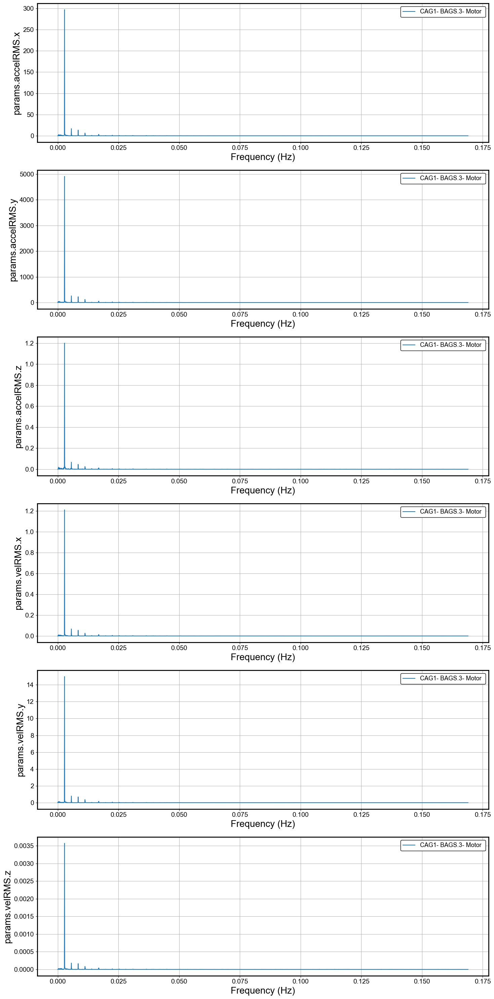

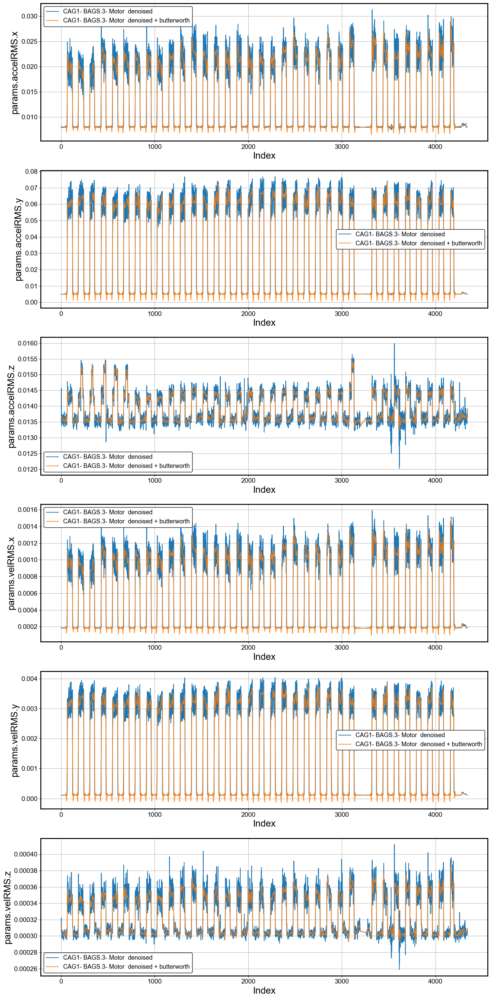

In [68]:
index = 8
threshold_list = [0.0, 0.0, 0.0, 0, 0, 0]
fig, ax, df_FFT = plot_FFT(df_list[index], dt_list[index], subset=subset, legend=name_list[index],
                           nrows=len(subset), ncols=1, figsize=(15, 30),
                           plot_filtered=False, threshold_list=threshold_list)

df_filtered = ifft_df(df_list[index], df_FFT=df_FFT, dt=dt_list[index],
                      subset=subset, threshold_list=threshold_list)

cutoff = 0.025
b, a = butterworth_filter(order=4, cutoff=cutoff,
                          fs=1/(dt_list[index]), btype='lowpass', plot=False)

df_butter_filtered = apply_butterfilter_df(df=df_list[index], order=4, cutoff=cutoff, subset=subset, fs=1/(dt_list[index]), btype='lowpass')
df_filtered_final.append(df_butter_filtered)

fig, ax = compare_filtered_signals(df_filtered, df_butter_filtered, subset=subset,
                                   legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 30))


### Rotuladora Sindel

6it [00:00, 1200.43it/s]
100%|██████████| 6/6 [00:00<00:00, 3000.58it/s]


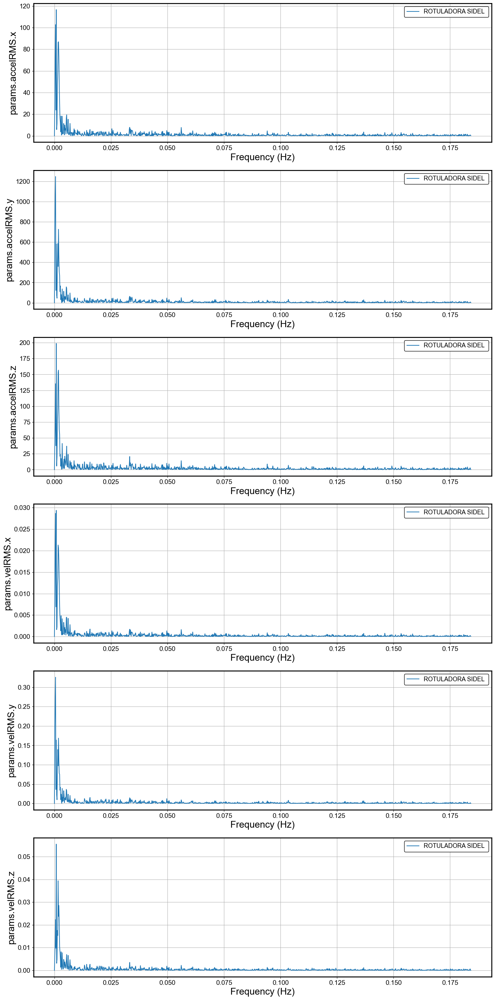

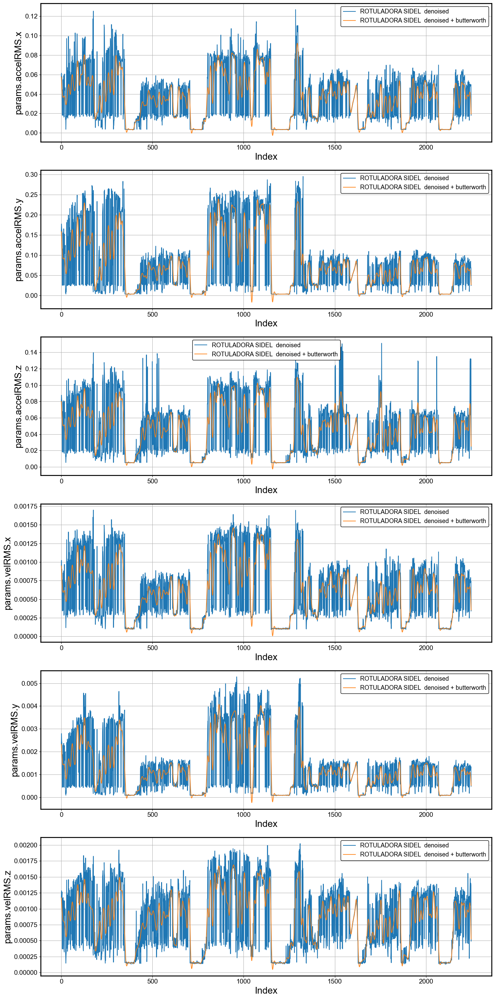

In [69]:
index = 9
threshold_list = [0.0, 0.0, 0.0, 0, 0, 0]
fig, ax, df_FFT = plot_FFT(df_list[index], dt_list[index], subset=subset, legend=name_list[index],
                           nrows=len(subset), ncols=1, figsize=(15, 30),
                           plot_filtered=False, threshold_list=threshold_list)

df_filtered = ifft_df(df_list[index], df_FFT=df_FFT, dt=dt_list[index],
                      subset=subset, threshold_list=threshold_list)

cutoff = 0.02
b, a = butterworth_filter(order=4, cutoff=cutoff,
                          fs=1/(dt_list[index]), btype='lowpass', plot=False)

df_butter_filtered = apply_butterfilter_df(
    df=df_list[index], order=4, cutoff=cutoff, subset=subset, fs=1/(dt_list[index]), btype='lowpass')
df_filtered_final.append(df_butter_filtered)

fig, ax = compare_filtered_signals(df_filtered, df_butter_filtered, subset=subset,
                                   legend=name_list[index], nrows=len(subset), ncols=1, figsize=(15, 30))


## Visualizing the filtered dataset

In [70]:
df_final = pd.DataFrame()

for i in range(len(df_list)):
    
    df_aux = pd.DataFrame(df_filtered_final[i]).T
    df_final = pd.concat([df_final,df_aux],axis=0,ignore_index=True)
    
df_final.columns = subset

In [71]:
df_final

,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.velRMS.x,params.velRMS.y,params.velRMS.z
0,0.003790,0.008091,0.009742,0.000102,-0.000280,0.000013
1,0.004255,0.000534,0.009783,0.000089,-0.000359,0.000026
2,0.005072,-0.004643,0.010110,0.000102,-0.000379,0.000064
3,0.006304,-0.006208,0.010812,0.000148,-0.000311,0.000133
4,0.007709,-0.004679,0.011715,0.000222,-0.000170,0.000215
...,...,...,...,...,...,...
33896,0.037765,0.056080,0.070127,0.000602,0.001002,0.000991
33897,0.034300,0.050472,0.062160,0.000555,0.000913,0.000904
33898,0.029914,0.043404,0.051595,0.000496,0.000800,0.000793
33899,0.024811,0.035186,0.039022,0.000428,0.000667,0.000665


In [72]:
df_final['name'] = df5['name']
df_final['modelType'] = df5['modelType']
df_final['Date'] = df5['createdAt']
df_final

,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.velRMS.x,params.velRMS.y,params.velRMS.z,name,modelType,Date
0,0.003790,0.008091,0.009742,0.000102,-0.000280,0.000013,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-06-01 00:03:33
1,0.004255,0.000534,0.009783,0.000089,-0.000359,0.000026,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-06-01 00:16:19
2,0.005072,-0.004643,0.010110,0.000102,-0.000379,0.000064,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-06-01 00:28:36
3,0.006304,-0.006208,0.010812,0.000148,-0.000311,0.000133,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-06-01 00:41:27
4,0.007709,-0.004679,0.011715,0.000222,-0.000170,0.000215,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-06-01 00:53:41
...,...,...,...,...,...,...,...,...,...
33896,0.037765,0.056080,0.070127,0.000602,0.001002,0.000991,ROTULADORA SIDEL,other,2021-07-06 23:58:03
33897,0.034300,0.050472,0.062160,0.000555,0.000913,0.000904,ROTULADORA SIDEL,other,2021-07-07 00:15:00
33898,0.029914,0.043404,0.051595,0.000496,0.000800,0.000793,ROTULADORA SIDEL,other,2021-07-07 00:32:38
33899,0.024811,0.035186,0.039022,0.000428,0.000667,0.000665,ROTULADORA SIDEL,other,2021-07-07 00:50:40


In [73]:
num_df = df_final._get_numeric_data()
nrows = len(list(num_df.columns))


def plotly_lineplot(df, x, y, label=True):
        
    if label:
        fig = px.line(df, x=x, y=y, color=label, height=600, width=1500)
        
    fig.show()
    return

In [74]:
column = df_final.columns[0]
plotly_lineplot(df_final, x='Date', y=column, label='name')

## Data scaling

In [75]:
#from sklearn.preprocessing import LabelEncoder

df_encoded = df_final.copy()

cols = ['name','modelType','Date']
#df_encoded[cols] = df_final[cols].apply(LabelEncoder().fit_transform)

df_encoded.drop(cols,axis=1,inplace=True)
df_encoded

,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.velRMS.x,params.velRMS.y,params.velRMS.z
0,0.003790,0.008091,0.009742,0.000102,-0.000280,0.000013
1,0.004255,0.000534,0.009783,0.000089,-0.000359,0.000026
2,0.005072,-0.004643,0.010110,0.000102,-0.000379,0.000064
3,0.006304,-0.006208,0.010812,0.000148,-0.000311,0.000133
4,0.007709,-0.004679,0.011715,0.000222,-0.000170,0.000215
...,...,...,...,...,...,...
33896,0.037765,0.056080,0.070127,0.000602,0.001002,0.000991
33897,0.034300,0.050472,0.062160,0.000555,0.000913,0.000904
33898,0.029914,0.043404,0.051595,0.000496,0.000800,0.000793
33899,0.024811,0.035186,0.039022,0.000428,0.000667,0.000665


In [76]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
df_scaled = pd.DataFrame(scaler.fit_transform(df_encoded),columns=df_encoded.columns)
df_scaled['name'] = df_final['name'].to_numpy()

In [77]:
df_scaled

,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.velRMS.x,params.velRMS.y,params.velRMS.z,name
0,-0.718541,-0.705534,-0.706060,-0.859367,-0.854061,-1.026997,Ventilador Acima do Elemento GA160 FF - Prédio...
1,-0.710028,-0.848757,-0.705365,-0.874470,-0.896030,-1.009685,Ventilador Acima do Elemento GA160 FF - Prédio...
2,-0.695088,-0.946885,-0.699758,-0.859874,-0.906572,-0.961349,Ventilador Acima do Elemento GA160 FF - Prédio...
3,-0.672540,-0.976557,-0.687735,-0.803266,-0.870563,-0.873722,Ventilador Acima do Elemento GA160 FF - Prédio...
4,-0.646843,-0.947574,-0.672255,-0.714921,-0.795497,-0.768505,Ventilador Acima do Elemento GA160 FF - Prédio...
...,...,...,...,...,...,...,...
33896,-0.096945,0.204055,0.328620,-0.256080,-0.173035,0.220945,ROTULADORA SIDEL
33897,-0.160338,0.097776,0.192101,-0.312894,-0.220065,0.110313,ROTULADORA SIDEL
33898,-0.240589,-0.036195,0.011078,-0.383763,-0.280380,-0.030543,ROTULADORA SIDEL
33899,-0.333949,-0.191973,-0.204353,-0.465566,-0.351160,-0.194849,ROTULADORA SIDEL


# Dimensionality reduction- PCA

To summarize the data to facilitate visualization, PCA was applied

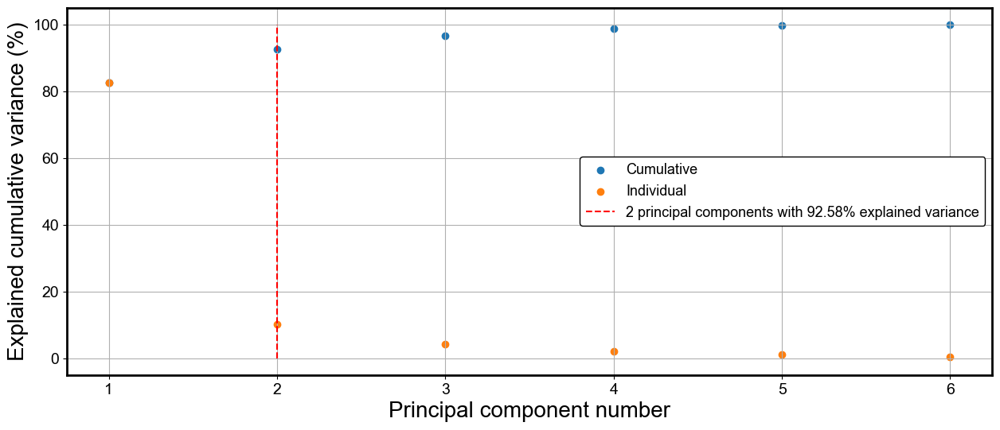

In [78]:
PCA1 = pca(df=df_scaled, threshold=0.9, label='name')
PCA1.plot_pca()

In [79]:
PCA1.plot_2d()

In [80]:
PCA1.plot_3d()

We can represent the dataset using 2-3 variables by applying PCA. 

Looking at the 2D and 3D plots, we notice that their is a region where all machines overlap at PC1 = -2 and PC2 = 0. 

Machine that are **NOT** in this region are:

- Tranformador 500 KVA
- CAG1 BAGS.12
- VTF - 61.1
- Boko MA-1510
- Ventilador GA75 FF

After removing these machines in the 3D plot we can better distinguish the overlap of the machines

The remaining machines all have some partial overlap. For some of them, the overlap is only for the outliers, such as Rotuladora Sidel and CAG1 - BAGS.3 for the remaining three machines.

The remaining machines share considerable overlap:

- Ventilador GA 160 (for one of its clusters.)
- RDF 61.1
- Motor bomba


Therefore, the remaining three machines share similarities. 

In [81]:
fig = px.histogram(df_scaled, x=df_scaled.columns[0], color='name',marginal='violin', nbins=300, width=1500, height=700)
fig.show()

Looking at the distributions, we can notice in the plots two scenarios depending on the machine:
- Scenario 1: There is a large concentration of points around a cluster centroid with clear outliers and spread. This spread is likely due pattern or condition changes in the equipment
- Scenario 2: There are two of more clusters, indicating two distinct operating regimes. There could still be noticable outliers

These scenarios are not exactly binary and it they may be hard to distinguish. This is my interpretation. 

Machines that are in scenario 1 are: 
- Ventilador GA 160
- Transformador 500 KVA
- Motor Bomba - Tanque de Expansão Tubo Verde
- VTF-61.1
- Rotuladora Sidel
- Boko MA- 1510
- Ventilador GA75 
- Rotuladora Sidel

Machines that are in scenario 2 are: 

- RDF-61.1
- CAG1 - BAGS.12 Motor
- CAG1 - BAGS.3 Motor

If we go back to the noise filtering chapter, we can notice that the three machines in scenario 2 have clear pattern changes compared to the other machines of scenario 1. 

Since, overall, there is no intersection between groups, the identification of vibration pattern changes and anomaly detection must be done for each individual machine. 

# Redoing PCA for an **individual** machine

In [82]:
df_aux = df_final.copy()
df_aux2 = df_aux.loc[(df_aux['name'] == name_list[0])]
df_aux2

,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.velRMS.x,params.velRMS.y,params.velRMS.z,name,modelType,Date
0,0.003790,0.008091,0.009742,0.000102,-0.000280,0.000013,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-06-01 00:03:33
1,0.004255,0.000534,0.009783,0.000089,-0.000359,0.000026,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-06-01 00:16:19
2,0.005072,-0.004643,0.010110,0.000102,-0.000379,0.000064,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-06-01 00:28:36
3,0.006304,-0.006208,0.010812,0.000148,-0.000311,0.000133,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-06-01 00:41:27
4,0.007709,-0.004679,0.011715,0.000222,-0.000170,0.000215,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-06-01 00:53:41
...,...,...,...,...,...,...,...,...,...
3981,0.012626,0.012939,0.011655,0.000297,0.000436,0.000198,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-07-07 00:16:41
3982,0.013269,0.010818,0.013018,0.000327,0.000430,0.000276,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-07-07 00:29:23
3983,0.011362,0.007872,0.013305,0.000254,0.000293,0.000324,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-07-07 00:42:13
3984,0.006461,0.005253,0.012146,0.000023,-0.000009,0.000313,Ventilador Acima do Elemento GA160 FF - Prédio...,compressor,2021-07-07 00:54:47


We are working with the "ventilador" in the example instead of all the machines

In [83]:
from sklearn.preprocessing import StandardScaler

cols = ['name', 'modelType', 'Date']

df_aux2.drop(cols, axis=1, inplace=True)
df_aux2

scaler = StandardScaler()
df_individual = pd.DataFrame(scaler.fit_transform(df_aux2), columns=df_aux2.columns)
df_individual

C:\Program Files\Python39\lib\site-packages\pandas\core\frame.py:4906: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.velRMS.x,params.velRMS.y,params.velRMS.z
0,-0.916317,-0.510802,-0.776073,-0.843561,-1.100929,-1.049107
1,-0.891811,-0.746987,-0.772921,-0.858616,-1.178136,-1.021453
2,-0.848803,-0.908806,-0.747478,-0.844066,-1.197529,-0.944238
3,-0.783893,-0.957739,-0.692927,-0.787637,-1.131285,-0.804258
4,-0.709921,-0.909944,-0.622689,-0.699573,-0.993192,-0.636181
...,...,...,...,...,...,...
3981,-0.450969,-0.359250,-0.627412,-0.609510,-0.400876,-0.671651
3982,-0.417093,-0.425560,-0.521388,-0.573228,-0.406862,-0.512732
3983,-0.517522,-0.517641,-0.499083,-0.661115,-0.540509,-0.414268
3984,-0.775653,-0.599515,-0.589230,-0.938077,-0.835770,-0.436028


In [84]:
PCA2 = pca(df=df_individual, threshold=0.97,label=False)

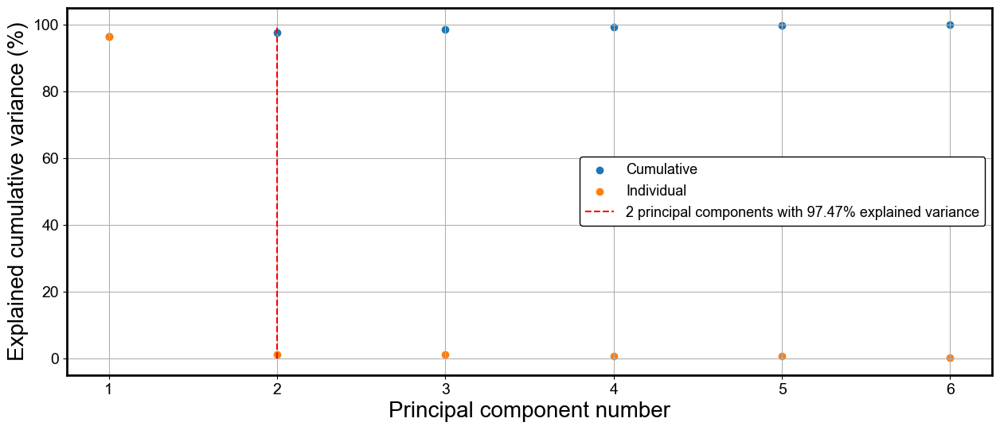

In [85]:
PCA2.plot_pca()

In [86]:
PCA2.plot_1d(label=False)

In [87]:
PCA2.plot_2d(label=False)

In [88]:
PCA2.plot_3d(label=False)

In [89]:
df_reduced = pd.DataFrame(PCA2.model_red.fit_transform(df_individual), columns=['PC1','PC2'])
df_reduced

,PC1,PC2
0,-2.122777,0.277135
1,-2.233705,0.206017
2,-2.241807,0.142868
3,-2.105496,0.092320
4,-1.866048,0.051282
...,...,...
3981,-1.273627,-0.011049
3982,-1.166257,0.004097
3983,-1.286239,0.089486
3984,-1.705114,0.292003


# Clustering an individual machine

In [90]:
cluster_kmeans = kmeans(df_reduced)

100%|██████████| 9/9 [00:06<00:00,  1.41it/s]


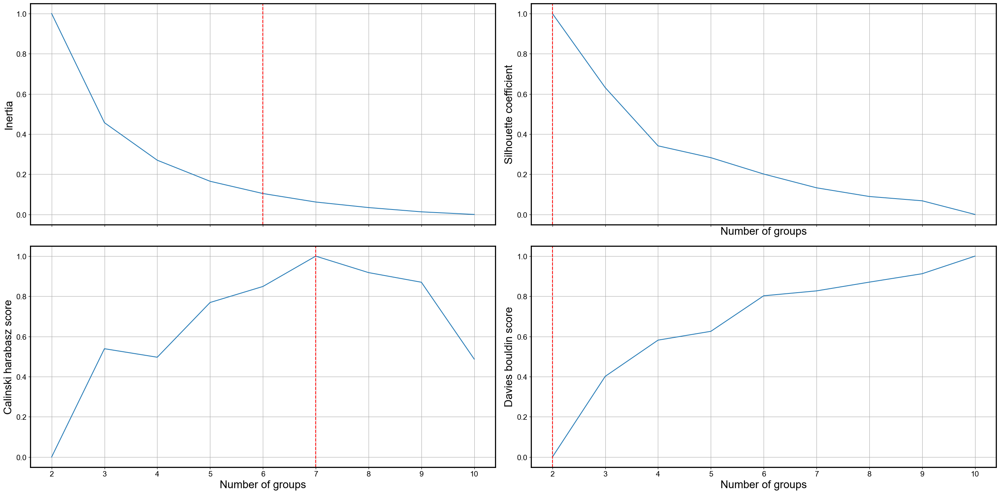

In [91]:
cluster_kmeans.cluster_criterion(10)

Look at the graphs of the four metrics, we can determine that the best solution would be the one that has the best overall metrics.

In this case, it would be 2 clusters. We will look at the 7 clusters case also.

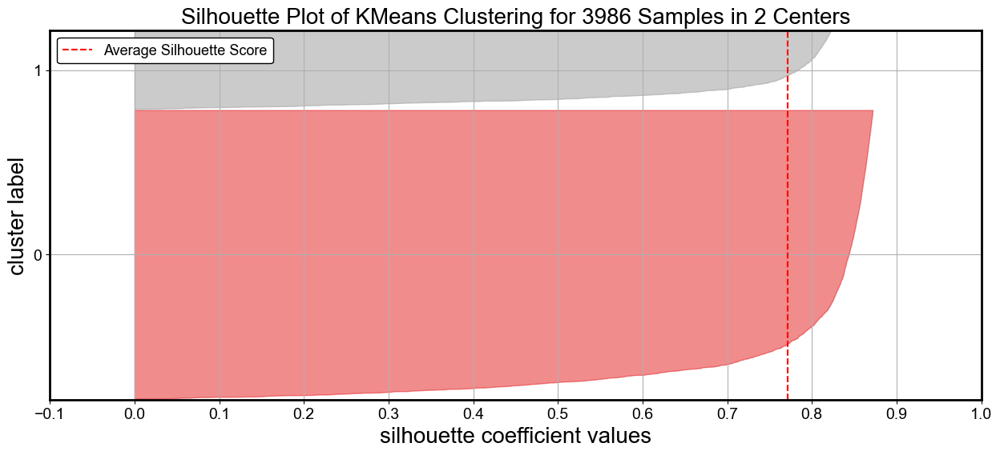

In [92]:
cluster_kmeans.create_model(n_clusters=2)
df_cluster2 = cluster_kmeans.clustering()
df_cluster2['cluster_kmeans'] = df_cluster2['cluster_kmeans'].astype('object')
cluster_kmeans.silhouette_plot()

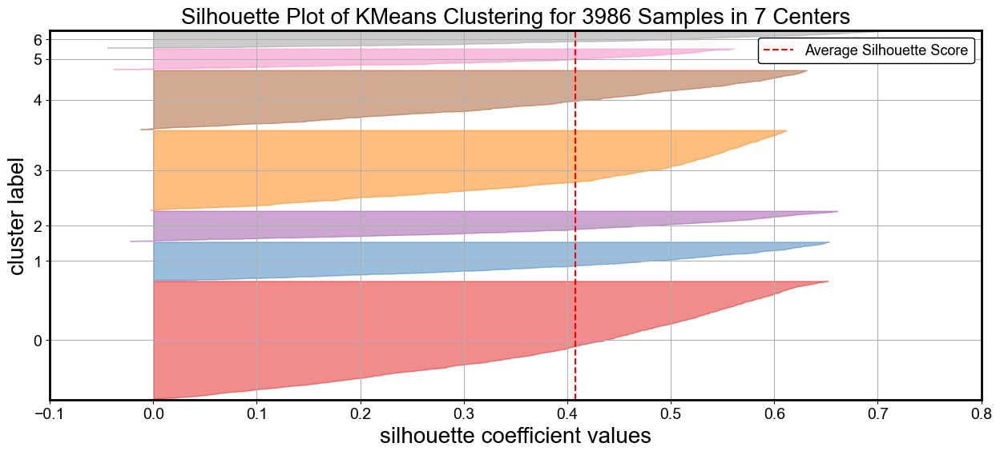

In [93]:
cluster_kmeans.create_model(n_clusters=7)
df_cluster7 = cluster_kmeans.clustering()
df_cluster7['cluster_kmeans'] = df_cluster7['cluster_kmeans'].astype('object')
cluster_kmeans.silhouette_plot()


# Visualizing the clusters - kmeans

In [94]:
fig = px.scatter(df_cluster2, x="PC1", y="PC2",color='cluster_kmeans', width=1200, height=600)
fig.update_traces(marker=dict(size=4))

In [95]:
fig = px.scatter(df_cluster7, x="PC1", y="PC2",color='cluster_kmeans', width=1200, height=600)
fig.update_traces(marker=dict(size=4))

Visually, we can see that the choice of 7 clusters seems very strange given the sparsity of some of these clusters (5 and 6 for example). We will use the 2 cluster solution

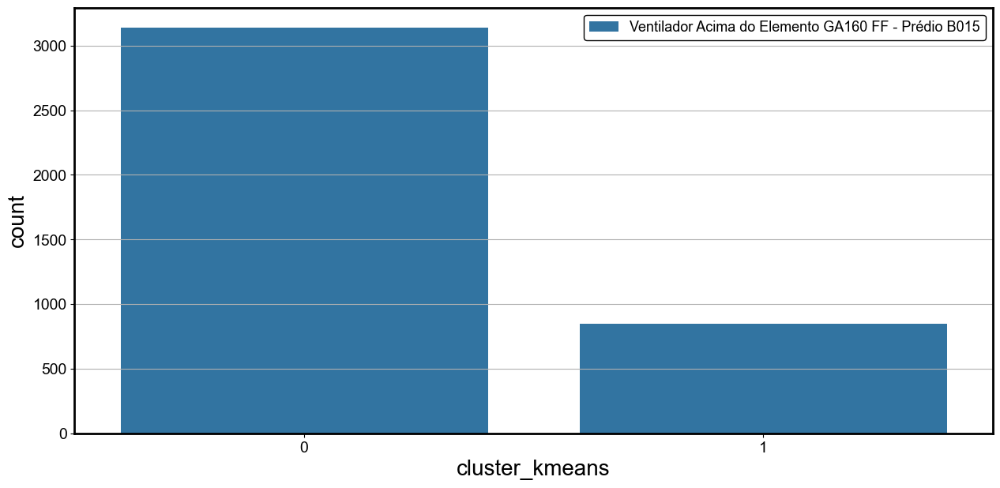

In [96]:
#%pylab
df_aux = df_cluster2.copy()
df_aux['Machine'] = df5['name']

fig, ax = plt.subplots(1, 1, figsize=(15, 7))
sns.countplot(data=df_aux, x='cluster_kmeans', hue='Machine', ax=ax)
ax.legend(loc='upper right')

In [97]:
df_aux


,PC1,PC2,cluster_kmeans,Machine
0,-2.122777,0.277135,0,Ventilador Acima do Elemento GA160 FF - Prédio...
1,-2.233705,0.206017,0,Ventilador Acima do Elemento GA160 FF - Prédio...
2,-2.241807,0.142868,0,Ventilador Acima do Elemento GA160 FF - Prédio...
3,-2.105496,0.092320,0,Ventilador Acima do Elemento GA160 FF - Prédio...
4,-1.866048,0.051282,0,Ventilador Acima do Elemento GA160 FF - Prédio...
...,...,...,...,...
3981,-1.273627,-0.011049,0,Ventilador Acima do Elemento GA160 FF - Prédio...
3982,-1.166257,0.004097,0,Ventilador Acima do Elemento GA160 FF - Prédio...
3983,-1.286239,0.089486,0,Ventilador Acima do Elemento GA160 FF - Prédio...
3984,-1.705114,0.292003,0,Ventilador Acima do Elemento GA160 FF - Prédio...


Looks like there are two main groups present here:

- Cluster 0: likely represents the more common condition
- Cluster 1: Change in condition

We can see in the plot below that the condition changes in the signal

In [98]:
column = df_final.columns[3]
plotly_lineplot(df_final, x='Date', y=column, label='name')

# Returning to the original domain to verify the hypothesis

In [99]:
df_inverse = pd.DataFrame(PCA2.model_red.inverse_transform(df_reduced), columns=subset)
df_inverse

,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.velRMS.x,params.velRMS.y,params.velRMS.z
0,-0.928919,-0.742232,-0.687853,-1.013321,-0.959360,-0.865365
1,-0.960168,-0.817951,-0.777407,-1.021844,-0.980923,-0.911142
2,-0.950743,-0.848485,-0.820242,-0.992387,-0.963155,-0.914863
3,-0.884478,-0.814955,-0.796585,-0.910318,-0.890621,-0.859508
4,-0.777721,-0.735450,-0.725118,-0.790941,-0.779142,-0.761958
...,...,...,...,...,...,...
3981,-0.521512,-0.521833,-0.523752,-0.515937,-0.516415,-0.520356
3982,-0.480419,-0.471708,-0.470696,-0.479820,-0.477625,-0.476396
3983,-0.547008,-0.483577,-0.465908,-0.573283,-0.555119,-0.524854
3984,-0.760169,-0.566254,-0.509056,-0.849965,-0.793763,-0.694650


## Visualizing reconstruction error

Original data plotted
Reduced data plotted
Error plotted


ValueError: too many values to unpack (expected 3)

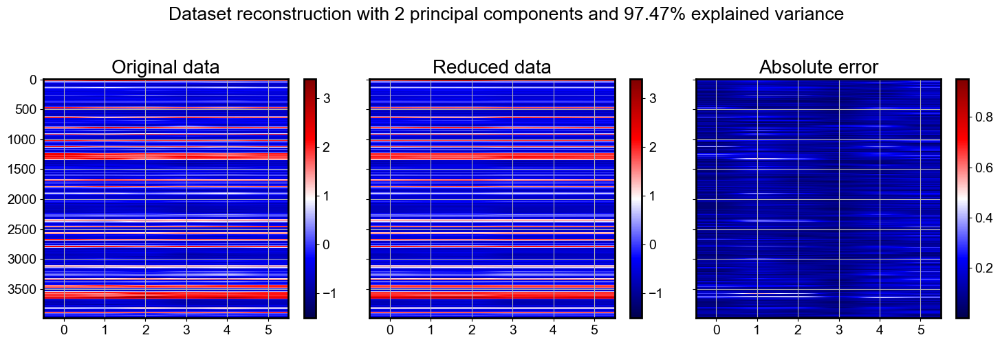

In [100]:
fig,ax,diff = PCA2.reconstruction_error(df_inverse.to_numpy())

print('Mean absolute error (MAE): {}'.format(diff.mean()))

In [ ]:
df_inverse['kmeans_clusters'] = df_cluster2['cluster_kmeans']
df_inverse['Date'] = df_date_list[0]
df_inverse

,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.velRMS.x,params.velRMS.y,params.velRMS.z,kmeans_clusters,Date
0,-0.928919,-0.742232,-0.687853,-1.013321,-0.959360,-0.865365,0,2021-06-01 00:03:33
1,-0.960168,-0.817951,-0.777407,-1.021844,-0.980923,-0.911142,0,2021-06-01 00:16:19
2,-0.950743,-0.848485,-0.820242,-0.992387,-0.963155,-0.914863,0,2021-06-01 00:28:36
3,-0.884478,-0.814955,-0.796585,-0.910318,-0.890621,-0.859508,0,2021-06-01 00:41:27
4,-0.777721,-0.735450,-0.725118,-0.790941,-0.779142,-0.761958,0,2021-06-01 00:53:41
...,...,...,...,...,...,...,...,...
3981,-0.521512,-0.521833,-0.523752,-0.515937,-0.516415,-0.520356,0,2021-07-07 00:16:41
3982,-0.480419,-0.471708,-0.470696,-0.479820,-0.477625,-0.476396,0,2021-07-07 00:29:23
3983,-0.547008,-0.483577,-0.465908,-0.573283,-0.555119,-0.524854,0,2021-07-07 00:42:13
3984,-0.760169,-0.566254,-0.509056,-0.849965,-0.793763,-0.694650,0,2021-07-07 00:54:47


## Visualizing pattern changes in the original dataset

100%|██████████| 6/6 [00:01<00:00,  3.89it/s]


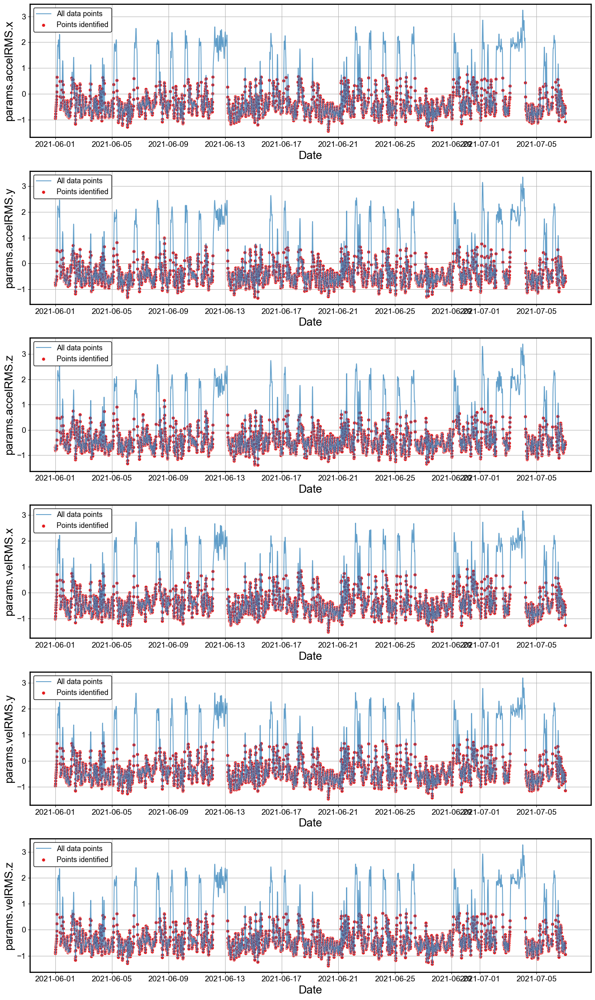

In [ ]:
fig,ax = show_pattern_changes(df=df_inverse, x='Date',label_col='kmeans_clusters',index=0,cols=subset, nrows=6, ncols=1, figsize=(15, 25))

Looks like the changes that occured in the machine were easily detected by kmeans clustering. Cluster 1 represents one type of condition while cluster 0 represents another (red points). This process can be repeated for any other machine to identify condition changes

# Question 3: Create a model to identify anomalies in an equipment

From question 2, we know how to identify pattern changes from one condition to another. What is not correctly classified in either condition can be considered as:

1.  A novel/new condition
2.  An anomaly or failure

We assume that there are no novel conditions in the given machine. 

Note that the 2D PCA was used to identify clusters that represent different operating conditions, but no outlier detection step was done. It is possible that there are points that correspond to neither clusters, and these will be used as anomalous points.

## Local outlier factor

In [ ]:
from sklearn.neighbors import LocalOutlierFactor

df_cluster2_num = df_cluster2._get_numeric_data().to_numpy()

clf = LocalOutlierFactor(n_neighbors=40, novelty=False,contamination='auto', n_jobs=-1)
y_pred = clf.fit_predict(df_cluster2_num)
y_pred

array([ 1,  1,  1, ...,  1,  1, -1])

In [ ]:
in_mask = [True if l == 1 else False for l in y_pred]
out_mask = [True if l == -1 else False for l in y_pred]

In [ ]:
df_cluster2_num


array([[-2.12277741,  0.27713506],
       [-2.23370546,  0.20601653],
       [-2.24180689,  0.14286829],
       ...,
       [-1.28623882,  0.08948582],
       [-1.70511379,  0.29200345],
       [-2.34389363,  0.58896082]])

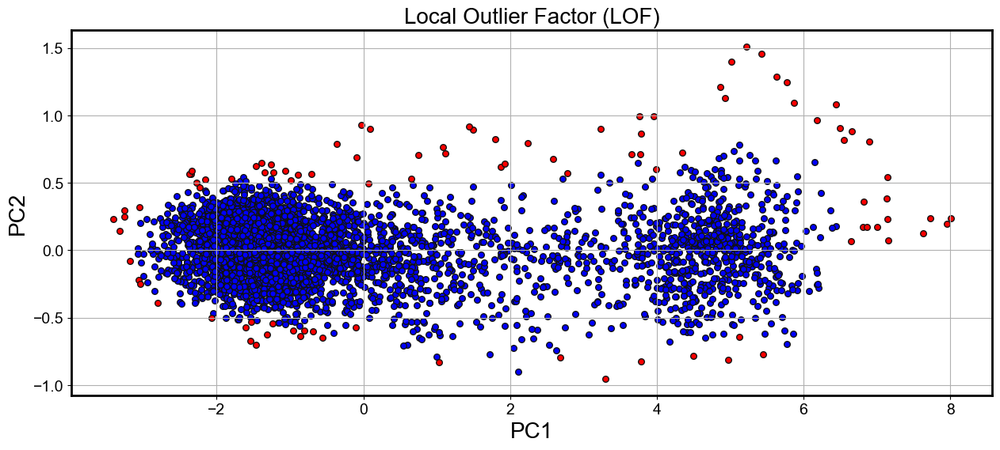

In [ ]:
plt.title("Local Outlier Factor (LOF)")

# inliers
a = plt.scatter(df_cluster2_num[in_mask, 0],
                df_cluster2_num[in_mask, 1], c='blue', edgecolor='k', s=30)

# outliers
b = plt.scatter(df_cluster2_num[out_mask, 0],
                df_cluster2_num[out_mask, 1], c='red', edgecolor='k', s=30)

plt.xlabel('PC1')
plt.ylabel('PC2')
plt.show()

In [ ]:
df_inverse = pd.DataFrame(PCA2.model_red.inverse_transform(df_reduced),columns=subset)
df_inverse['Outliers'] = y_pred
df_inverse['Outliers'] = df_inverse['Outliers'].map({1:0,-1:1})
df_inverse['Date'] = df_date_list[0]
df_inverse

,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.velRMS.x,params.velRMS.y,params.velRMS.z,Outliers,Date
0,-0.928919,-0.742232,-0.687853,-1.013321,-0.959360,-0.865365,0,2021-06-01 00:03:33
1,-0.960168,-0.817951,-0.777407,-1.021844,-0.980923,-0.911142,0,2021-06-01 00:16:19
2,-0.950743,-0.848485,-0.820242,-0.992387,-0.963155,-0.914863,0,2021-06-01 00:28:36
3,-0.884478,-0.814955,-0.796585,-0.910318,-0.890621,-0.859508,0,2021-06-01 00:41:27
4,-0.777721,-0.735450,-0.725118,-0.790941,-0.779142,-0.761958,0,2021-06-01 00:53:41
...,...,...,...,...,...,...,...,...
3981,-0.521512,-0.521833,-0.523752,-0.515937,-0.516415,-0.520356,0,2021-07-07 00:16:41
3982,-0.480419,-0.471708,-0.470696,-0.479820,-0.477625,-0.476396,0,2021-07-07 00:29:23
3983,-0.547008,-0.483577,-0.465908,-0.573283,-0.555119,-0.524854,0,2021-07-07 00:42:13
3984,-0.760169,-0.566254,-0.509056,-0.849965,-0.793763,-0.694650,0,2021-07-07 00:54:47


100%|██████████| 6/6 [00:01<00:00,  3.42it/s]


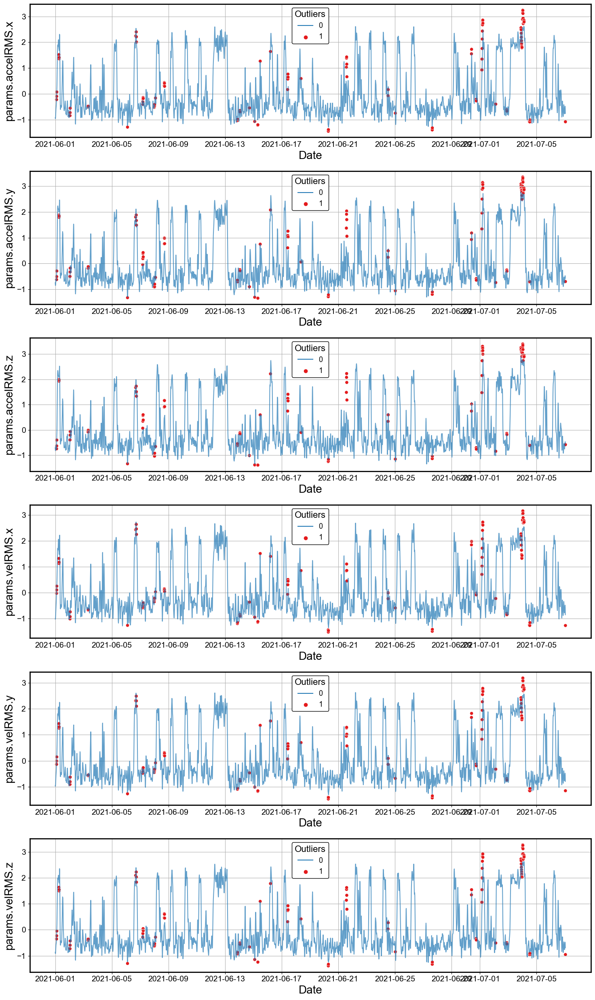

In [ ]:
df_anomaly = df_inverse.loc[df_inverse['Outliers'] == 1]
df_normal = df_inverse.loc[df_inverse['Outliers'] == 0]

fig, ax = plt.subplots(6, 1, figsize = (15, 25), tight_layout=True)
ax = ax.reshape((6,))
iax = 0

for s in tqdm(subset):
    sns.lineplot(data=df_normal, x='Date', y=s, ax=ax[iax], hue='Outliers',alpha=0.7)
    sns.scatterplot(data=df_anomaly, x='Date', y=s,ax=ax[iax], hue='Outliers', palette='Set1')
    iax += 1

Local outlier factor did not give a good solution

## DBSCAN

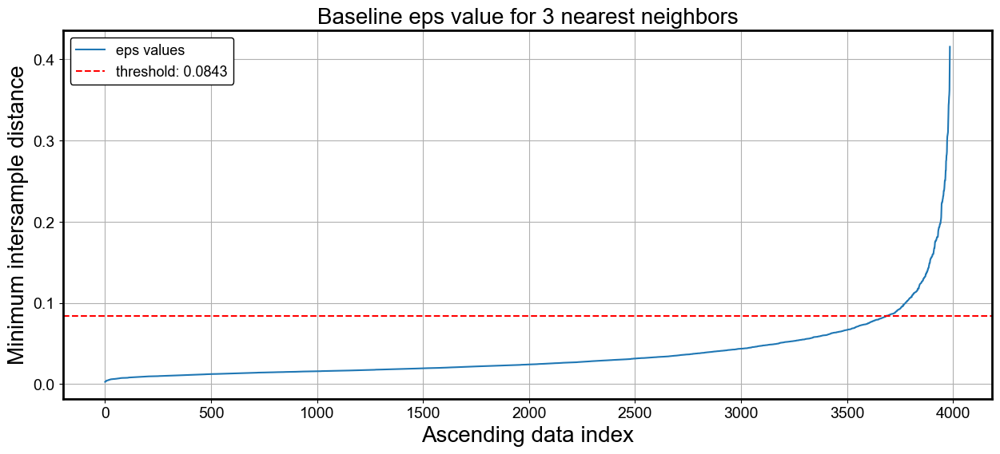

In [ ]:
DB = dbscan(pd.DataFrame(pd.DataFrame(df_cluster2_num, columns=df_reduced.columns)))
DB.plot_baseline_eps()

100%|██████████| 5/5 [00:01<00:00,  2.94it/s]


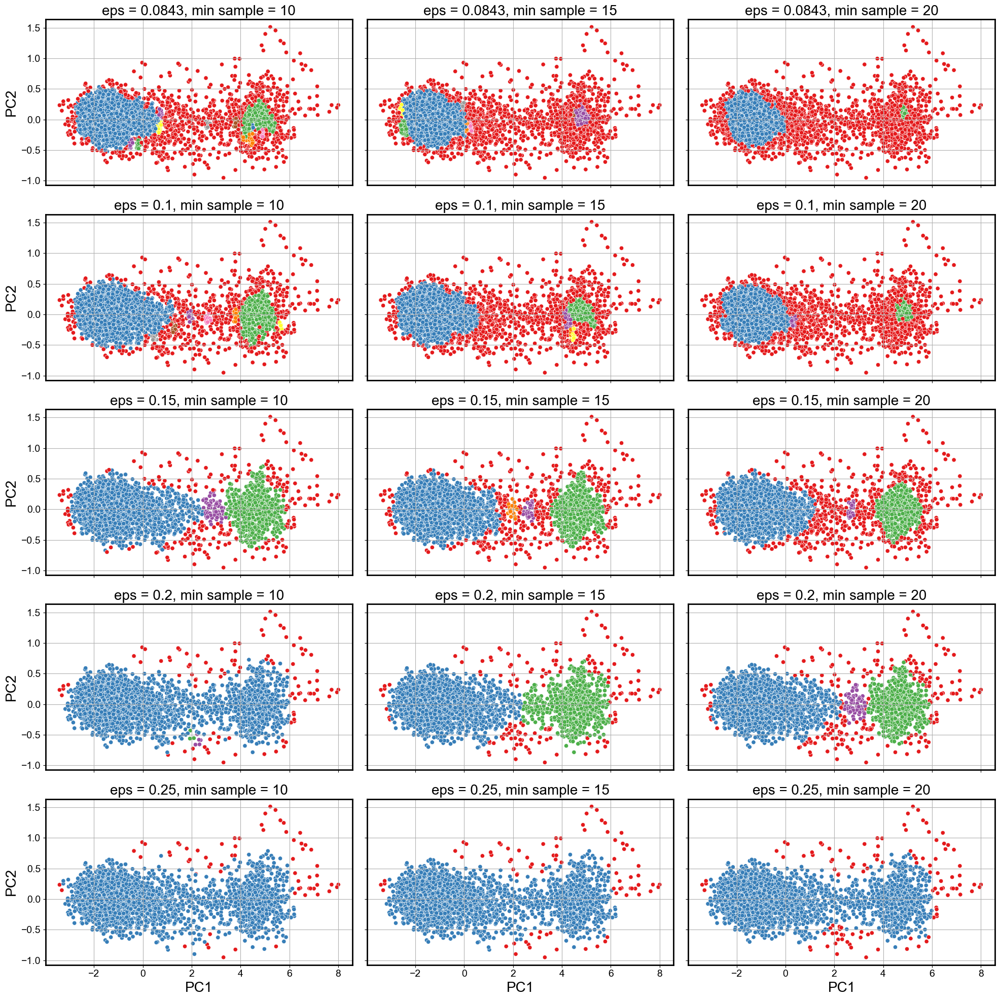

In [ ]:
#%pylab
DB.plot_hyperparameters(nrows=5,ncols=3,eps_list=[0.0843, 0.1,0.15,0.2,0.25], min_samples_list=[10,15,20],figsize=(20,20),remove_outliers=False)

The hyperparamter combination that accurately divides the data into two clusters and the rest being anomalous points are given by:

- eps= 0.2
- min sample=15

In [ ]:
DB.create_model(eps=0.2,msamples=15)
df_dbscan = DB.clustering()
df_dbscan['cluster_dbscan'] = df_dbscan['cluster_dbscan'].astype('object')
df_dbscan.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3986 entries, 0 to 3985
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   PC1             3986 non-null   float64
 1   PC2             3986 non-null   float64
 2   cluster_dbscan  3986 non-null   object 
dtypes: float64(2), object(1)
memory usage: 93.5+ KB


In [ ]:
df_dbscan

,PC1,PC2,cluster_dbscan
0,-2.122777,0.277135,0
1,-2.233705,0.206017,0
2,-2.241807,0.142868,0
3,-2.105496,0.092320,0
4,-1.866048,0.051282,0
...,...,...,...
3981,-1.273627,-0.011049,0
3982,-1.166257,0.004097,0
3983,-1.286239,0.089486,0
3984,-1.705114,0.292003,0


In [ ]:
fig = px.scatter(df_dbscan, x="PC1", y="PC2",color='cluster_dbscan', width=1200, height=600)
fig.update_traces(marker=dict(size=4))

## Checking the anomalous points in the original domain

Original data plotted
Reduced data plotted
Error plotted
Mean absolute error (MAE): 0.12178307356572149


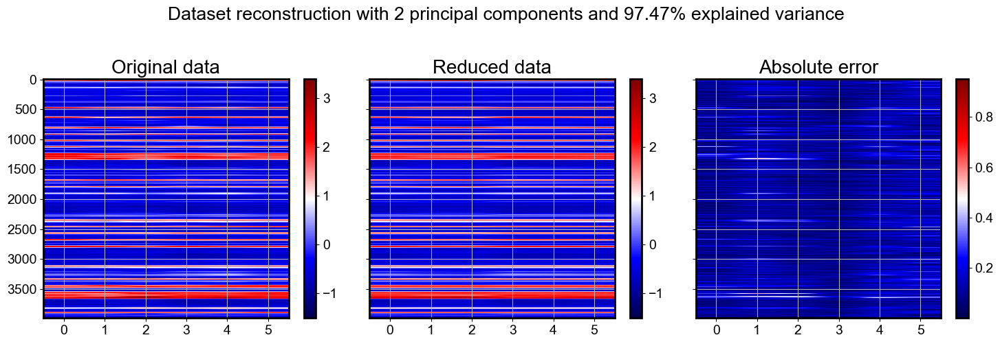

In [ ]:
df_inverse_db = pd.DataFrame(PCA2.model_red.inverse_transform(df_dbscan._get_numeric_data()), columns=subset)

fig, ax, diff = PCA2.reconstruction_error(df_inverse_db.to_numpy())
print('Mean absolute error (MAE): {}'.format(diff.mean()))

In [ ]:
df_inverse_db['db_cluster'] = df_dbscan['cluster_dbscan']
df_inverse_db['Date'] = df_date_list[0]

100%|██████████| 6/6 [00:02<00:00,  2.86it/s]


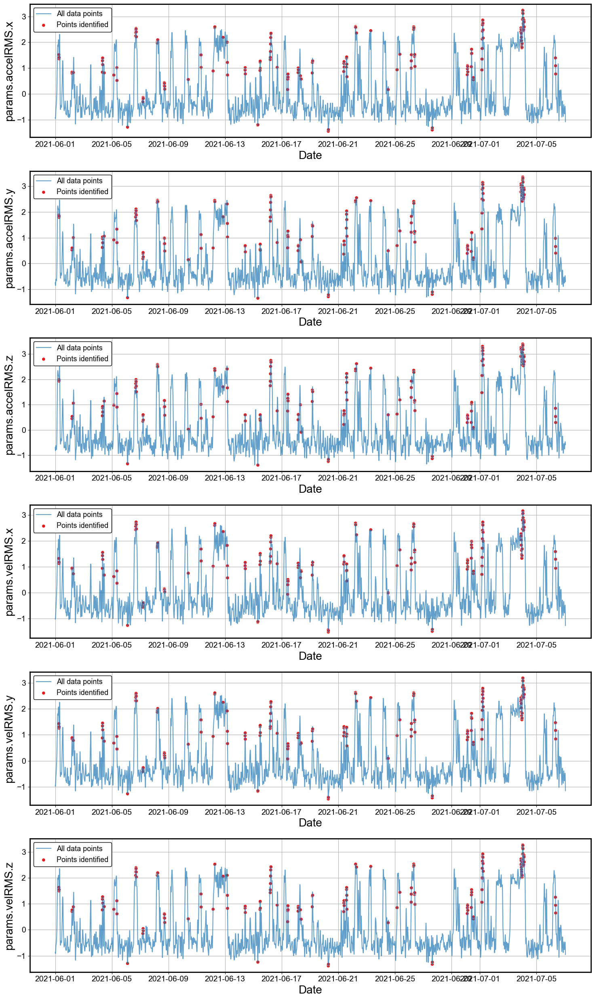

In [ ]:
fig, ax = show_pattern_changes(df=df_inverse_db, x='Date', label_col='db_cluster',index=-1, cols=subset, nrows=6, ncols=1, figsize=(15, 25))